In [1]:
%load_ext autoreload
%autoreload 2
import pandas as pd
import sys; sys.path.append('../')
from pathlib import Path
from tqdm import tqdm
import json
import pickle
import os
import numpy as np
from astropy.modeling.models import Ellipse2D
from astropy.coordinates import Angle
from regions import PixCoord, EllipsePixelRegion
import seaborn as sns;
import statistics
from statistics import mean, NormalDist, median
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [12, 12]
plt.rcParams['figure.dpi'] = 120

from matplotlib.patches import Ellipse
import matplotlib.image as mpimg

In [2]:
elipses_data = Path("..\cells_ellipses.csv")

In [3]:
df=pd.read_csv(elipses_data)
df

,filename,file_size,file_attributes,region_count,region_id,region_shape_attributes,region_attributes
0,p1_0299_6.jpg,393922,{},34,0,"{""name"":""ellipse"",""cx"":472,""cy"":261,""rx"":12.51...","{""region_class"":""1""}"
1,p1_0299_6.jpg,393922,{},34,1,"{""name"":""ellipse"",""cx"":625,""cy"":376,""rx"":21.33...","{""region_class"":""1""}"
2,p1_0299_6.jpg,393922,{},34,2,"{""name"":""ellipse"",""cx"":635,""cy"":291,""rx"":15.33...","{""region_class"":""1""}"
3,p1_0299_6.jpg,393922,{},34,3,"{""name"":""ellipse"",""cx"":663,""cy"":205,""rx"":14,""r...","{""region_class"":""1""}"
4,p1_0299_6.jpg,393922,{},34,4,"{""name"":""ellipse"",""cx"":319,""cy"":307,""rx"":26,""r...","{""region_class"":""1""}"
...,...,...,...,...,...,...,...
3294,p23_0287_6.jpg,391717,{},0,0,{},{}
3295,p23_0287_7.jpg,326561,{},0,0,{},{}
3296,p23_0287_8.jpg,307907,{},0,0,{},{}
3297,p23_0287_11.jpg,374209,{},0,0,{},{}


In [6]:
df=df[df.region_count!=0]

In [7]:
ellipses = {
    'filename':[],
    'center_x':[],
    'center_y':[],
    'radius_x':[],
    'radius_y':[],
    'theta_rad':[],
    'label':[]
}
for row_id, df_x in df.iterrows():
    try:
        region_class = df_x.region_attributes
        labels=pd.json_normalize(json.loads(region_class))
        region_c = int(labels.region_class.values)
        ellipses['label'].append(region_c)
        #
        shapes=pd.json_normalize(json.loads(df_x.region_shape_attributes))
        ellipses['center_x'].append(shapes.cx.values[0])
        ellipses['center_y'].append(shapes.cy.values[0])
        ellipses['radius_x'].append(shapes.rx.values[0])
        ellipses['radius_y'].append(shapes.ry.values[0])
        ellipses['theta_rad'].append(shapes.theta.values[0])
        ellipses['filename'].append(df_x.filename)
        
    except Exception as e:
         print(df_x.filename,row_id,x.region_class.values,e)
ellipses_df= pd.DataFrame(ellipses)

<AxesSubplot:>

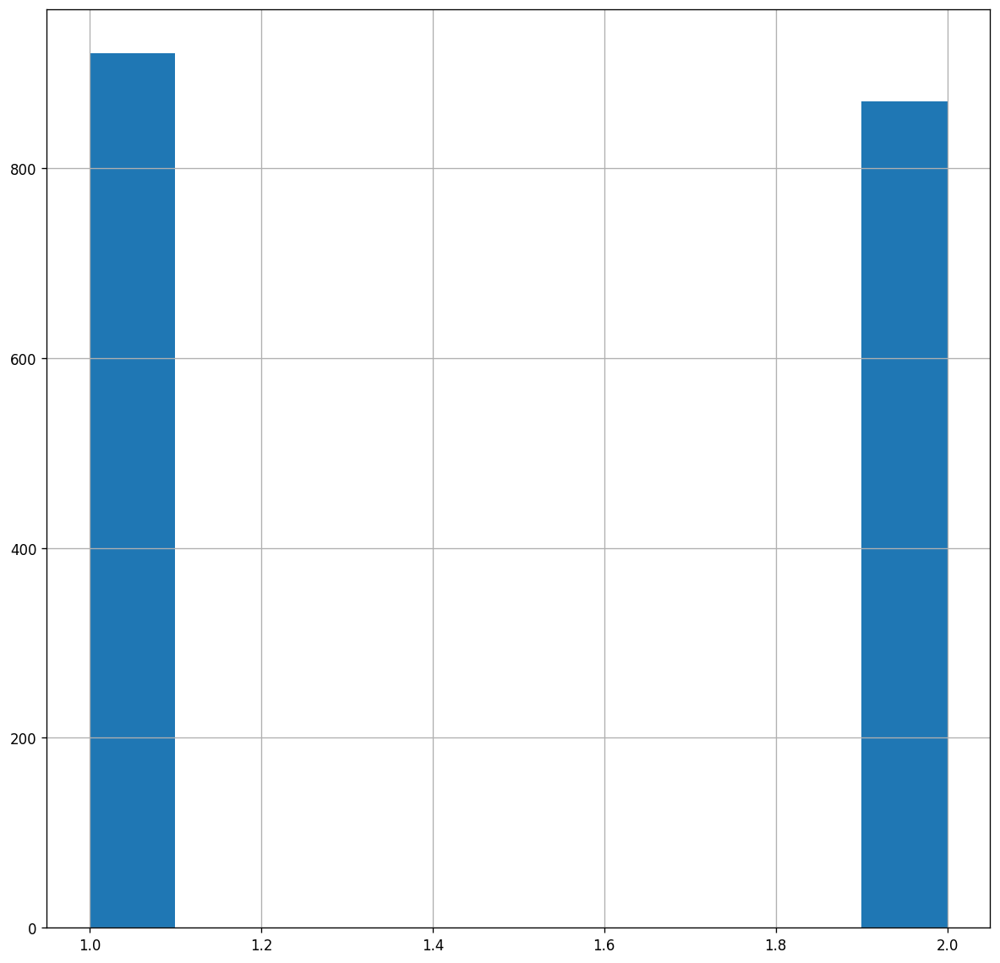

In [8]:
ellipses_df.label.hist()

<AxesSubplot:>

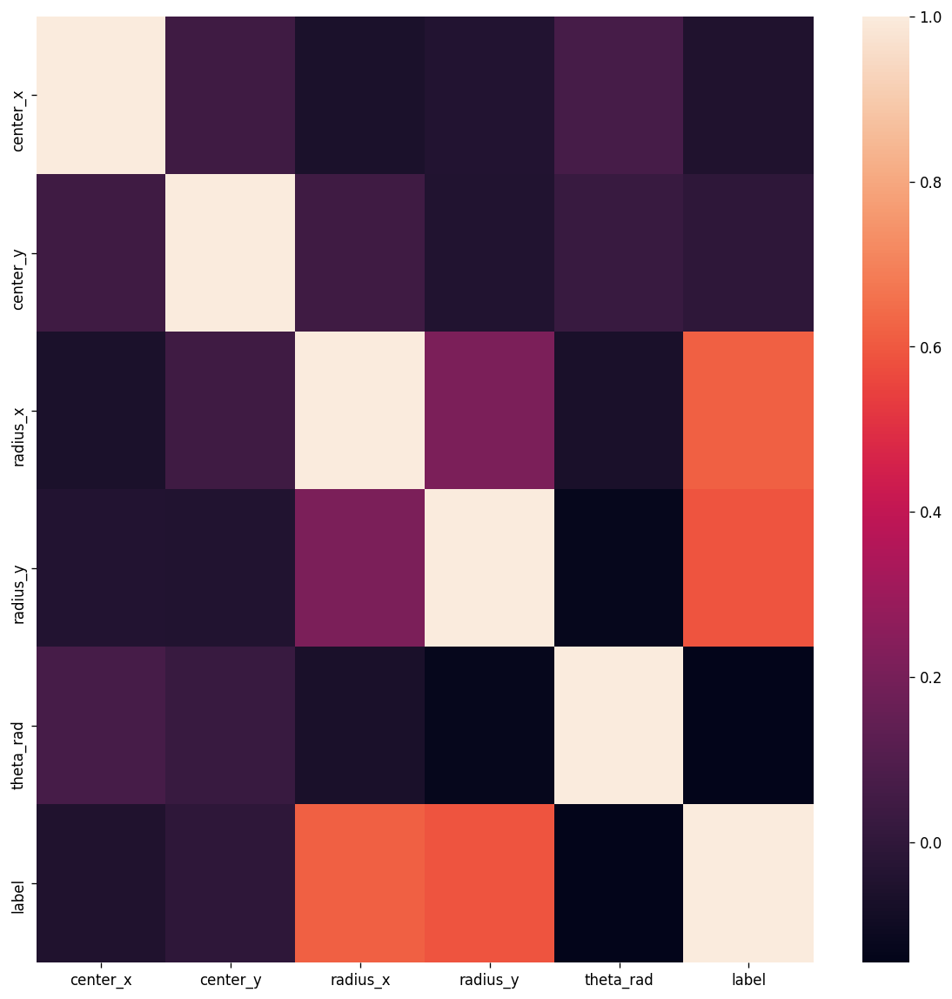

In [9]:
sns.heatmap(ellipses_df.corr())

In [10]:
data_path = Path("../data/Ki67/SHIDC-B-Ki-67/Train/")

In [19]:
colors = {'1':"blue",
         '2':'red'}

def rad_to_deg(rad):
    return rad*57.2957795


def show_ellipses(filename):
    filepath = os.path.join(data_path,filename)
    assert os.path.exists(filepath)
    print(filepath)
    img = mpimg.imread(filepath)
    ax = plt.gca()
    for ids, row in ellipses_df[ellipses_df.filename=="p1_0299_6.jpg"].iterrows():
        ax.add_patch(Ellipse((row.center_x,row.center_y),
                                width=row.radius_x*2,
                                height=row.radius_y*2,
                                angle=rad_to_deg(row.theta_rad), 
                                facecolor='none',
                                edgecolor=colors[str(row.label)]))
        
      
    plt.imshow(img)

..\data\Ki67\SHIDC-B-Ki-67\Train\p1_0299_6.jpg


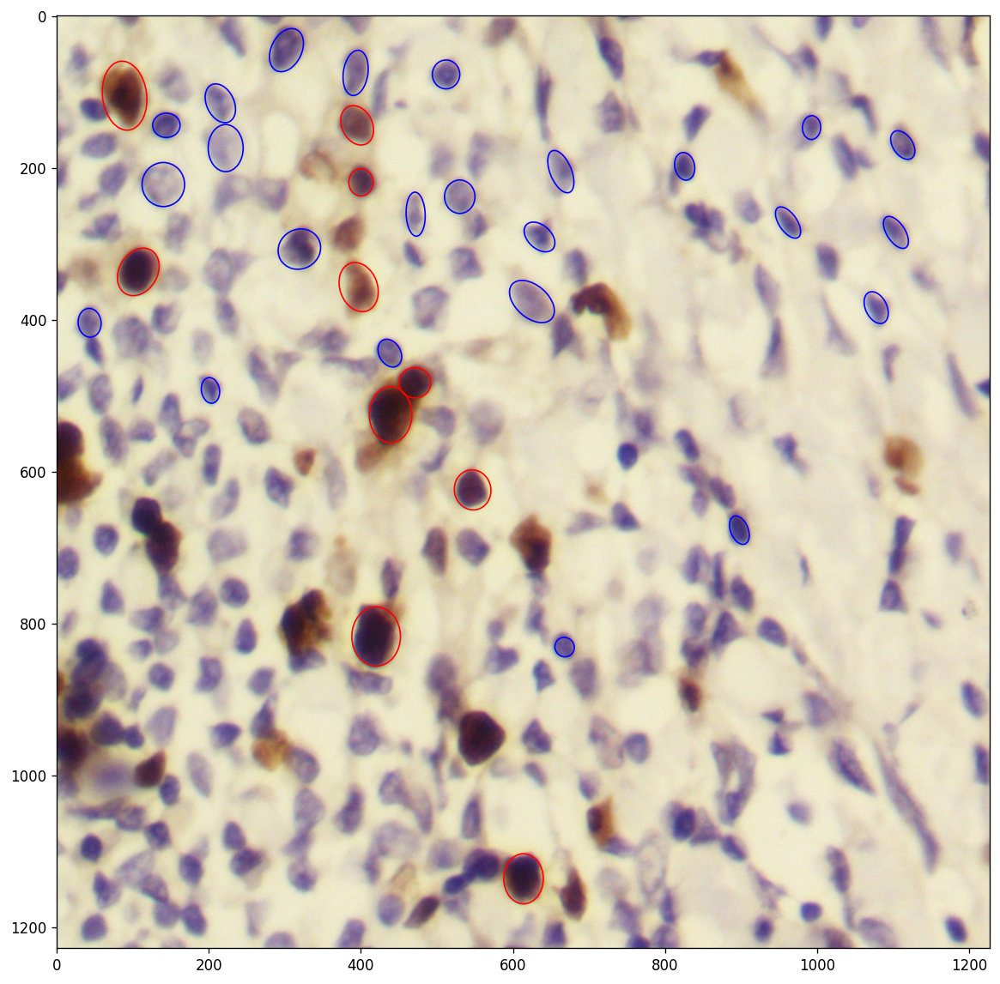

In [12]:
show_ellipses("p1_0299_6.jpg")

..\data\Ki67\SHIDC-B-Ki-67\Train\p1_0299_6.jpg


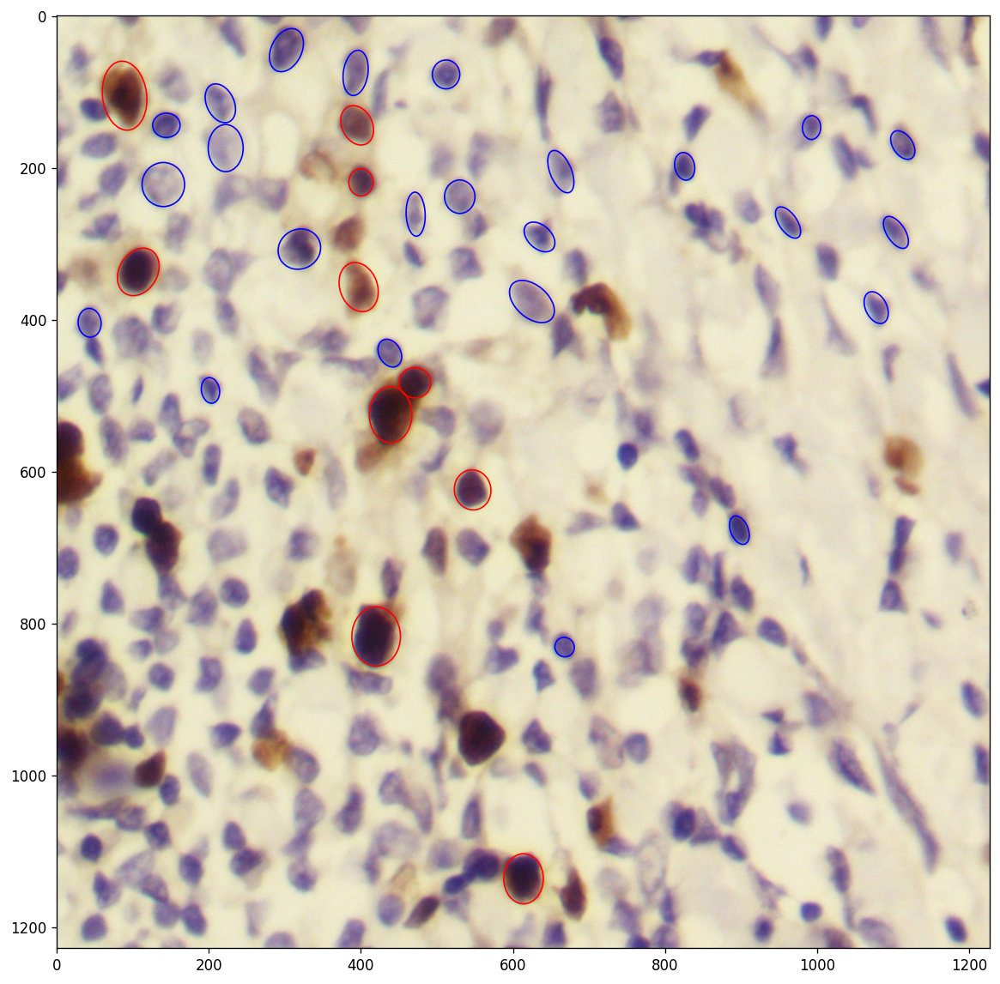

In [288]:
show_ellipses("p1_0299_6.jpg")

In [289]:
def check_ellipse(elipse_params,x,y):
    center_x=elipse_params.center_x
    center_y=elipse_params.center_y
    radius_x = elipse_params.radius_x
    radius_y = elipse_params.radius_y
    
    ellipse_eq = (((x-center_x)**2)/(radius_x**2))+(((y-center_y)**2)/(radius_y**2))
    if ellipse_eq <= 1:
        return True
    else:
        return False
    
def check_ellipse_rotated(elipse_params,x,y):
    
    center_x=elipse_params.center_x
    center_y=elipse_params.center_y
    radius_x = elipse_params.radius_x
    radius_y = elipse_params.radius_y
    
    angle=elipse_params.theta_rad

    ellipse_eq_1 = (((x-center_x)*cos(angle)+(y-center_y)*sin(angle))**2)/(radius_x)**2
    ellipse_eq_2 = (((x-center_x)*sin(angle)-(y-center_y)*cos(angle))**2)/(radius_y)**2
    if ellipse_eq_1+ellipse_eq_2 <= 1:
        return True
    else:
        return False

In [290]:
import PIL
from PIL import Image
import requests
from io import BytesIO
from PIL import ImageFilter
from PIL import ImageEnhance
from IPython.display import display
import numpy as np
from math import sin, cos
def get_ellipse(df,df_id,plot=False):
    elipse_params = df.iloc[df_id]
   # print(elipse_params)
    filepath = os.path.join(data_path,elipse_params.filename)
    assert os.path.exists(filepath)
    #print(filepath)
    pix_color_inside=[]
    
    
    with Image.open(filepath) as img:   
        #x_range = range(img.width)
        #y_range = range(img.height)
        img_hsv = img.convert('HSV')
        #print(img.getpixel((1,0)))
       # print(img_hsv.getpixel((1,0)))
        
        radius_sum = int(elipse_params.radius_x+elipse_params.radius_y)
        start_x = elipse_params.center_x-radius_sum
        start_y = elipse_params.center_y-radius_sum
        if start_x < 0:
            start_x = 0
        if start_y < 0:
            start_y = 0
        end_x = elipse_params.center_x+radius_sum
        end_y = elipse_params.center_y+radius_sum
        if end_x > img_hsv.width:
            end_x = img_hsv.width
        if end_y > img_hsv.height:
            end_y = img_hsv.height
            
        x_range = range(start_x,end_x)
        y_range = range(start_y,end_y)
        for x in x_range:
            for y in y_range:
                if check_ellipse_rotated(elipse_params,x,y):
                    pix_color_inside.append(img_hsv.getpixel((x,y)))
                    if plot:
                        img_hsv.putpixel((x,y),(255, 0, 0, 255))
        if plot:
            img_hsv.putpixel((elipse_params.center_x,elipse_params.center_y),(0,255,0,255))
            
            img_hsv.putpixel((int(elipse_params.center_x+elipse_params.radius_x),
                          int( elipse_params.center_y+elipse_params.radius_y)),(0,255,0,255))
            
            
        if plot:
            img_hsv.show()
            img.show()
    return pix_color_inside

In [19]:
import time

start = time.time()
x=get_ellipse(ellipses_df,1,plot=True)
end = time.time()
print(end - start)

3.683356523513794


In [20]:
get_ellipse(ellipses_df,1,plot=True)

[(29, 27, 214),
 (30, 26, 212),
 (30, 26, 208),
 (29, 24, 212),
 (35, 22, 205),
 (35, 22, 208),
 (35, 22, 206),
 (36, 24, 210),
 (34, 29, 214),
 (27, 31, 213),
 (27, 31, 213),
 (26, 29, 209),
 (29, 28, 208),
 (26, 26, 204),
 (29, 25, 204),
 (29, 25, 200),
 (35, 22, 203),
 (35, 22, 201),
 (35, 22, 205),
 (29, 24, 208),
 (30, 30, 211),
 (30, 30, 210),
 (30, 29, 215),
 (31, 30, 215),
 (34, 28, 220),
 (25, 37, 217),
 (24, 36, 212),
 (23, 34, 212),
 (20, 33, 207),
 (21, 30, 203),
 (21, 25, 199),
 (21, 25, 200),
 (24, 24, 196),
 (21, 23, 198),
 (24, 22, 195),
 (24, 21, 201),
 (24, 21, 201),
 (28, 22, 204),
 (23, 27, 204),
 (26, 29, 208),
 (26, 29, 208),
 (29, 27, 212),
 (30, 26, 211),
 (33, 28, 214),
 (36, 26, 211),
 (23, 39, 217),
 (21, 38, 213),
 (20, 37, 211),
 (19, 35, 207),
 (18, 31, 202),
 (16, 29, 197),
 (16, 27, 196),
 (14, 22, 195),
 (18, 21, 194),
 (18, 21, 192),
 (22, 19, 193),
 (22, 19, 195),
 (22, 19, 199),
 (21, 22, 201),
 (21, 25, 200),
 (17, 27, 204),
 (23, 27, 206),
 (26, 25

In [21]:
ellipses_df.size

12537

In [22]:
pixels_per_row=[]
for i in tqdm(range(len(ellipses_df.index))):
    row = ellipses_df.iloc[i]
    pixels=get_ellipse(ellipses_df,i,plot=False)
    pixels_per_row.append(pixels)
ellipses_df['pixels']=pixels_per_row

  1%|▉                                                                               | 21/1791 [00:06<09:16,  3.18it/s]


KeyboardInterrupt: 

In [ ]:
ellipses_df

In [ ]:
import pickle

In [24]:
filename='elipses_hsv_pixels.pickle'

In [32]:
#with open(filename, 'wb') as handle:
#    pickle.dump(ellipses_df, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [25]:
with open(filename, 'rb') as handle:
    ellipses_df = pickle.load(handle)

In [26]:
ellipses_df

,filename,center_x,center_y,radius_x,radius_y,theta_rad,label,pixels
0,p1_0299_6.jpg,472,261,12.510,29.000,-0.040,1,"[(10, 26, 192), (7, 29, 193), (7, 29, 193), (7..."
1,p1_0299_6.jpg,625,376,21.333,34.493,-0.854,1,"[(29, 27, 214), (30, 26, 212), (30, 26, 208), ..."
2,p1_0299_6.jpg,635,291,15.333,23.589,2.316,1,"[(239, 14, 194), (231, 12, 191), (212, 9, 186)..."
3,p1_0299_6.jpg,663,205,14.000,29.590,-0.393,1,"[(18, 11, 193), (23, 14, 196), (29, 16, 197), ..."
4,p1_0299_6.jpg,319,307,26.000,28.474,-2.045,1,"[(35, 53, 222), (34, 52, 220), (31, 50, 218), ..."
...,...,...,...,...,...,...,...,...
1786,p3_0248_1.jpg,344,75,35.355,21.000,-0.785,2,"[(25, 61, 157), (25, 60, 159), (27, 56, 153), ..."
1787,p3_0248_1.jpg,705,1012,57.245,35.000,-0.338,2,"[(40, 58, 189), (40, 59, 185), (40, 56, 184), ..."
1788,p3_0248_1.jpg,1005,1096,51.000,31.000,0.000,2,"[(162, 10, 146), (207, 15, 133), (200, 20, 135..."
1789,p3_0248_6.jpg,296,163,41.000,41.000,0.000,2,"[(24, 56, 136), (251, 44, 126), (251, 44, 127)..."


In [27]:
for ids, row in ellipses_df[ellipses_df.label==1].iterrows():
    print(row)
    print(zip(*row.pixels))
    break

filename                                         p1_0299_6.jpg
center_x                                                   472
center_y                                                   261
radius_x                                                 12.51
radius_y                                                  29.0
theta_rad                                                -0.04
label                                                        1
pixels       [(10, 26, 192), (7, 29, 193), (7, 29, 193), (7...
Name: 0, dtype: object


In [31]:
color_dist_1 = {
    'hue' : [],
    'saturation' : [],
    'volumne' : [],
    'hue_median' : [],
    'saturation_median' : [],
    'volumne_median' : [],
    #'grayscale' : []
}
color_dist_2 = {
    'hue' : [],
    'saturation' : [],
    'volumne' : [],
     'hue_median' : [],
    'saturation_median' : [],
    'volumne_median' : [],
   # 'grayscale' : []
}

for ids, row in ellipses_df[ellipses_df.label==1].iterrows():
    h,s,v = zip(*row.pixels)
    hm=median(h)
    sm=median(s)
    vm=median(v)
    color_dist_1['hue'].extend(h)
    color_dist_1['saturation'].extend(s)
    color_dist_1['volumne'].extend(v)
    
    color_dist_1['hue_median'].append(hm)
    color_dist_1['saturation_median'].append(sm)
    color_dist_1['volumne_median'].append(vm)
    #grey= 0.2989 * r + 0.5870 * g + 0.1140 * b
   # color_dist_1_mean['grayscale'].append(grey)
    
for ids, row in ellipses_df[ellipses_df.label==2].iterrows():
    h,s,v = zip(*row.pixels)
    hm=median(h)
    sm=median(s)
    vm=median(v)
    color_dist_2['hue'].extend(h)
    color_dist_2['saturation'].extend(s)
    color_dist_2['volumne'].extend(v)
    #
    color_dist_2['hue_median'].append(hm)
    color_dist_2['saturation_median'].append(sm)
    color_dist_2['volumne_median'].append(vm)

In [318]:
color_df_1=pd.DataFrame(color_dist_1,columns=['hue_median','saturation_median','volumne_median'])
sigma=statistics.pstdev(color_dist_1['hue_median'])
mu=statistics.mean(color_dist_1['hue_median'])
hue_dist_m = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_dist_1['saturation_median'])
mu=statistics.mean(color_dist_1['saturation_median'])
saturation_dist_m = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_dist_1['volumne_median'])
mu=statistics.mean(color_dist_1['volumne_median'])
volumne_dist_m = NormalDist(mu,sigma)

blue_cells_dist = {
    'hue_med':hue_dist_m,
    'saturation_med':saturation_dist_m,
    'volumne_med':volumne_dist_m,
}
for key in blue_cells_dist.keys():
    print(key)
    print(blue_cells_dist[key])

hue_med
NormalDist(mu=184.98805646036917, sigma=13.690580569546032)
saturation_med
NormalDist(mu=59.25407166123779, sigma=19.295759302753112)
volumne_med
NormalDist(mu=163.071661237785, sigma=11.81532113975374)


In [39]:
color_df_full_1=pd.DataFrame(color_dist_1,columns=['hue','saturation','volumne'])
sigma=statistics.pstdev(color_df_full_1['hue'])
mu=statistics.mean(color_df_full_1['hue'])
hue_dist = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_df_full_1['saturation'])
mu=statistics.mean(color_df_full_1['saturation'])
saturation_dist = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_df_full_1['volumne'])
mu=statistics.mean(color_df_full_1['volumne'])
volumne_dist = NormalDist(mu,sigma)

blue_cells_dist = {
    'hue':hue_dist,
    'saturation':saturation_dist,
    'volumne':volumne_dist,
}
for key in blue_cells_dist.keys():
    print(key)
    print(blue_cells_dist[key])

hue
NormalDist(mu=174.1349496647854, sigma=55.59560465928427)
saturation
NormalDist(mu=54.98590209072872, sigma=27.540041702921595)
volumne
NormalDist(mu=166.54236121421533, sigma=18.113197013287362)


In [35]:
colors = ["#FF0B04", "#5AFF00","#4374B3"]
sns.set_palette(sns.color_palette(colors))

Text(0.5, 0.98, 'Ki67 - Komórki niebieskie')

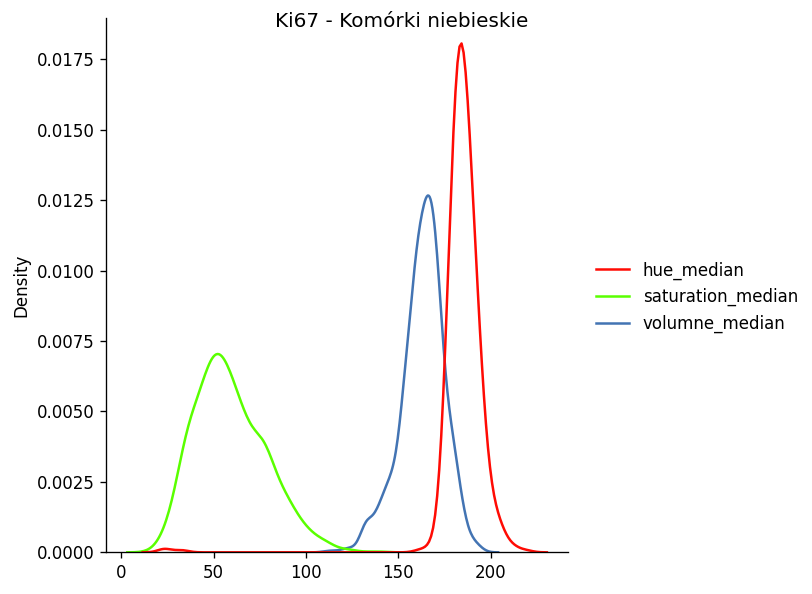

In [321]:
plot = sns.displot(color_df_1,kind="kde")
plot.fig.suptitle("Ki67 - Komórki niebieskie")

Text(0.5, 0.98, 'Ki-67 - Blue cells ')

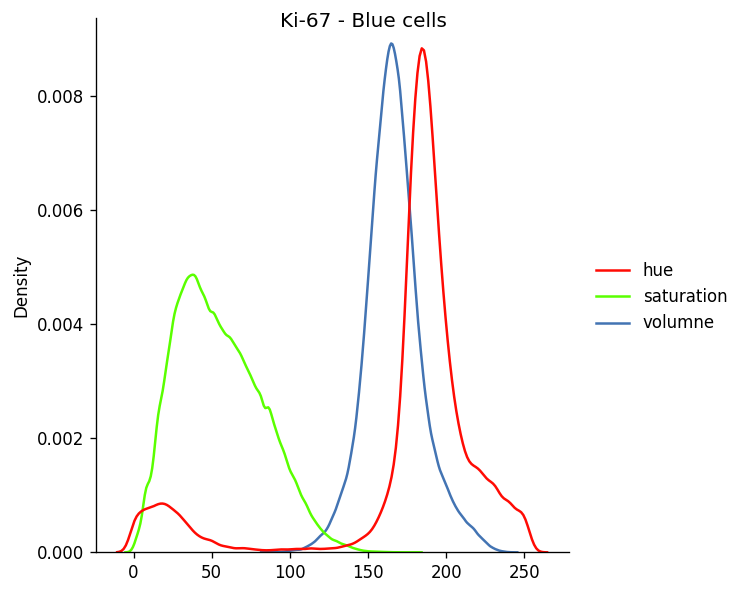

In [47]:
plot = sns.displot(color_df_full_1,kind="kde")
plot.fig.suptitle("Ki-67 - Blue cells ")

Text(0.5, 0.98, 'Ki67 - Komórki brąz')

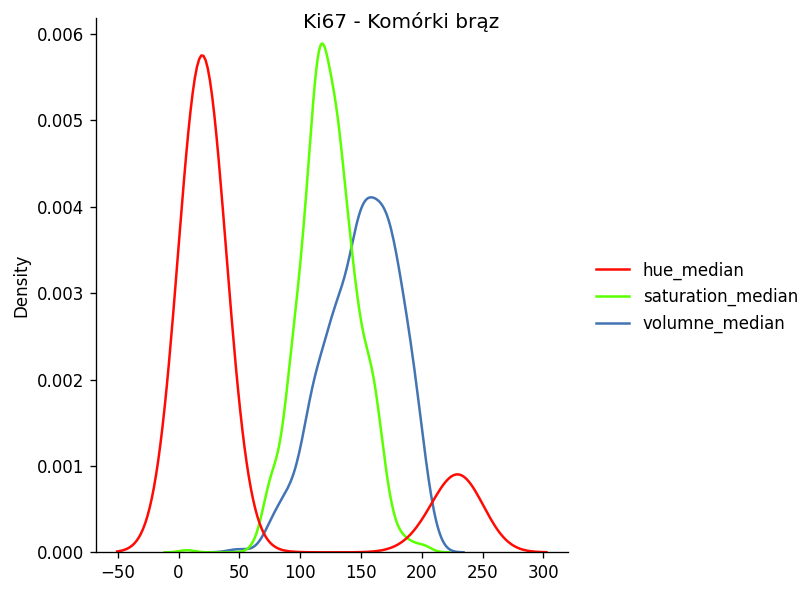

In [324]:
color_df_2=pd.DataFrame(color_dist_2,columns=['hue_median','saturation_median','volumne_median'])

plot = sns.displot(color_df_2,kind="kde")
plot.fig.suptitle("Ki67 - Komórki brąz")

In [54]:
color_df_full_2=pd.DataFrame(color_dist_2,columns=['hue','saturation','volumne'])
color_df_full_2=color_df_full_2[color_df_full_2.hue.between(0,150)]
sigma=statistics.pstdev(color_df_full_2['hue'])
mu=statistics.mean(color_df_full_2['hue'])
hue_dist = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_df_full_2['saturation'])
mu=statistics.mean(color_df_full_2['saturation'])
saturation_dist = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_df_full_2['volumne'])
mu=statistics.mean(color_df_full_2['volumne'])
volumne_dist = NormalDist(mu,sigma)

blue_cells_dist = {
    'hue':hue_dist,
    'saturation':saturation_dist,
    'volumne':volumne_dist,
}
for key in blue_cells_dist.keys():
    print(key)
    print(blue_cells_dist[key])

hue
NormalDist(mu=18.249281378903724, sigma=8.543627617376782)
saturation
NormalDist(mu=127.03885404091271, sigma=37.0661995625947)
volumne
NormalDist(mu=162.69562749471217, sigma=30.060679303651387)


Text(0.5, 0.98, 'Ki67 - brown cells')

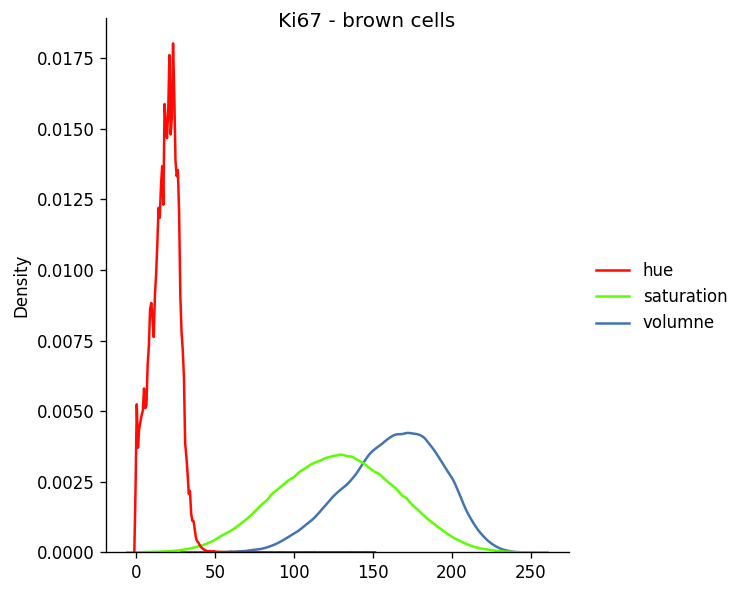

In [55]:
color_df_2=pd.DataFrame(color_df_full_2,columns=['hue','saturation','volumne'])
plot = sns.displot(color_df_2,kind="kde")
plot.fig.suptitle("Ki67 - brown cells")

In [325]:
rx = ellipses_df.radius_x
ry = ellipses_df.radius_x

Text(0.5, 0.98, 'Ki67 - Cells radius x')

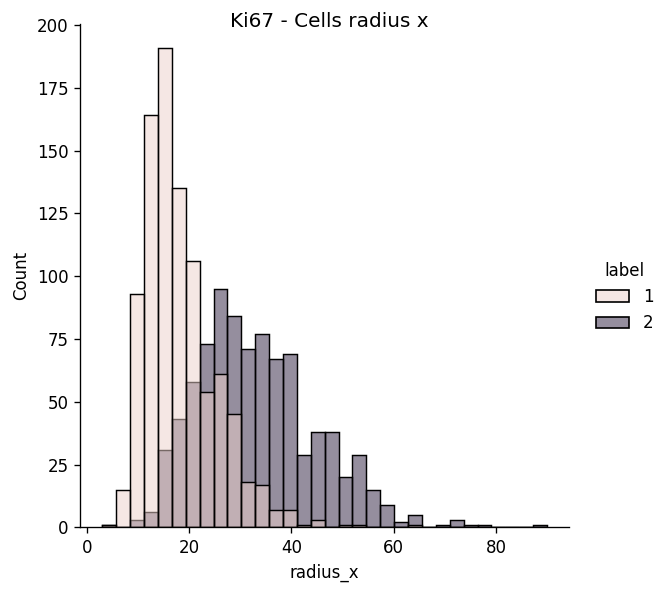

In [58]:
colors = ["#FF0B04", "#5AFF00"]
sns.set_palette(sns.color_palette(colors))
plot = sns.displot(ellipses_df,hue='label',x="radius_x")
plot.fig.suptitle("Ki67 - Cells radius x")

Text(0.5, 0.98, 'Ki67 - Cells radius y')

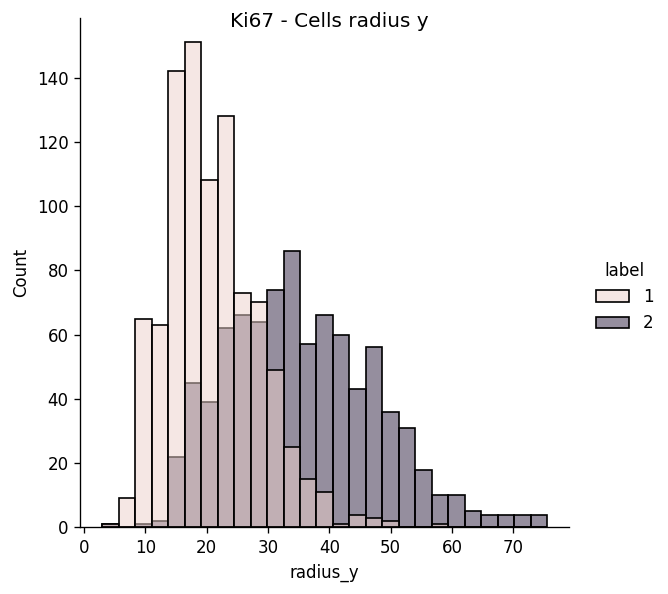

In [59]:
colors = ["#FF0B04", "#5AFF00"]
sns.set_palette(sns.color_palette(colors))
plot = sns.displot(ellipses_df,hue='label',x="radius_y")
plot.fig.suptitle("Ki67 - Cells radius y")

In [328]:
print("blue cells")
print('x_radius mean: ',ellipses_df[ellipses_df.label==1].radius_x.mean())
print('x_radius median: ',ellipses_df[ellipses_df.label==1].radius_x.median())
print('y_radius mean: ',ellipses_df[ellipses_df.label==1].radius_y.mean())
print('y_radius median: ',ellipses_df[ellipses_df.label==1].radius_y.median())
print("brown cells")
print('x_radius mean: ',ellipses_df[ellipses_df.label==2].radius_x.mean())
print('x_radius median: ',ellipses_df[ellipses_df.label==2].radius_x.median())
print('y_radius mean: ',ellipses_df[ellipses_df.label==2].radius_y.mean())
print('y_radius median: ',ellipses_df[ellipses_df.label==2].radius_y.median())

blue cells
x_radius mean:  18.225491856677525
x_radius median:  16.5
y_radius mean:  20.90031596091205
y_radius median:  20.0
brown cells
x_radius mean:  33.28823908045977
x_radius median:  31.753
y_radius mean:  35.54914482758621
y_radius median:  34.025999999999996


In [329]:
from statistics import mean
color_dist_1_mean = {
    'hue' : [],
    'saturiation' : [],
    'volumne' : []
}
color_dist_2_mean = {
    'hue' : [],
    'saturiation' : [],
    'volumne' : []
}

for ids, row in ellipses_df[ellipses_df.label==1].iterrows():
    h,s,v = zip(*row.pixels)
    h=median(h)
    s=median(s)
    v=median(v)
    color_dist_1_mean['hue'].append(h)
    color_dist_1_mean['saturiation'].append(s)
    color_dist_1_mean['volumne'].append(v)
    
for ids, row in ellipses_df[ellipses_df.label==2].iterrows():
    h,s,v = zip(*row.pixels)
    h=mean(h)
    s=mean(s)
    v=mean(v)
    color_dist_2_mean['hue'].append(h)
    color_dist_2_mean['saturiation'].append(s)
    color_dist_2_mean['volumne'].append(v)
    

Text(0.5, 0.98, 'Ki67 - Komórki niebieskie')

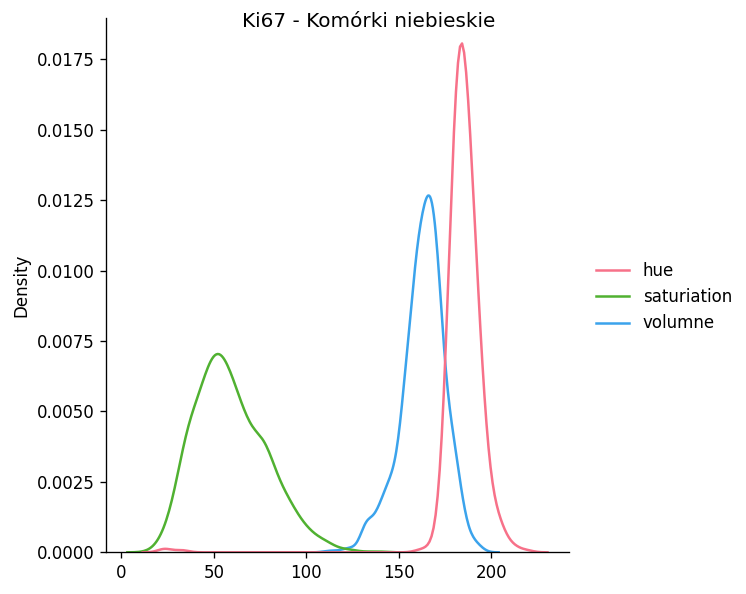

In [330]:
color_df_1=pd.DataFrame(color_dist_1_mean)
colors = ["#FF0B04", "#5AFF00"]
sns.set_palette(sns.color_palette(colors))
plot = sns.displot(color_df_1,kind="kde")
plot.fig.suptitle("Ki67 - Komórki niebieskie")

Text(0.5, 0.98, 'Ki67 - Komórki brąz')

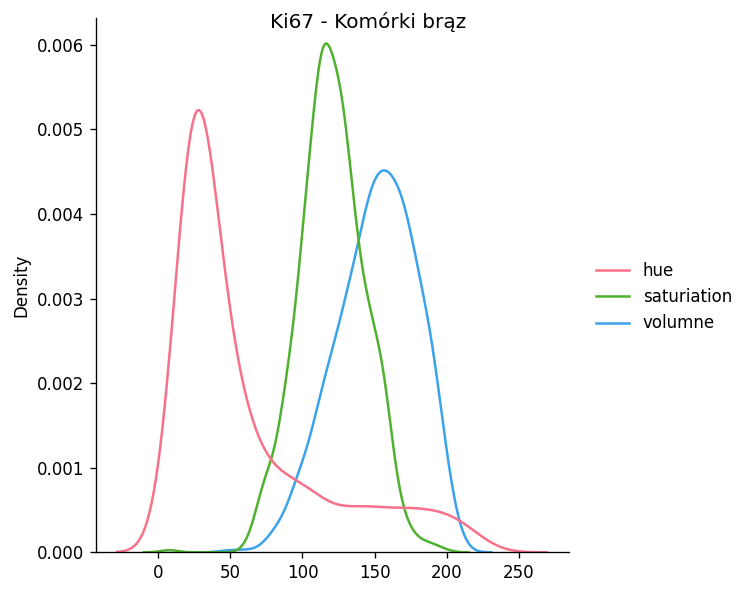

In [331]:
color_df_2=pd.DataFrame(color_dist_2_mean)
colors = ["#FF0B04", "#5AFF00"]
sns.set_palette(sns.color_palette(colors))
plot = sns.displot(color_df_2,kind="kde")
plot.fig.suptitle("Ki67 - Komórki brąz")

# Mean Ellipse as labled from vgg 

In [332]:
ellipses_mean = {
    'filename':[],
    'center_x':[],
    'center_y':[],
    'radius_x':[],
    'radius_y':[],
    'theta_rad':[],
    'label':[]
}

for row_id, df_x in df.iterrows():
    try:
        region_class = df_x.region_attributes
        labels=pd.json_normalize(json.loads(region_class))
        region_c = int(labels.region_class.values)
        ellipses_mean['label'].append(region_c)
        #
        shapes=pd.json_normalize(json.loads(df_x.region_shape_attributes))
        ellipses_mean['center_x'].append(shapes.cx.values[0])
        ellipses_mean['center_y'].append(shapes.cy.values[0])
        ellipses_mean['radius_x'].append(shapes.rx.values[0])
        ellipses_mean['radius_y'].append(shapes.ry.values[0])
        ellipses_mean['theta_rad'].append(shapes.theta.values[0])
        ellipses_mean['filename'].append(df_x.filename)
        
    except Exception as e:
         print(df_x.filename,row_id,x.region_class.values,e)
ellipses_df_mean= pd.DataFrame(ellipses_mean)

In [333]:
ellipses_df

,filename,center_x,center_y,radius_x,radius_y,theta_rad,label,pixels
0,p1_0299_6.jpg,472,261,12.510,29.000,-0.040,1,"[(10, 26, 192), (7, 29, 193), (7, 29, 193), (7..."
1,p1_0299_6.jpg,625,376,21.333,34.493,-0.854,1,"[(29, 27, 214), (30, 26, 212), (30, 26, 208), ..."
2,p1_0299_6.jpg,635,291,15.333,23.589,2.316,1,"[(239, 14, 194), (231, 12, 191), (212, 9, 186)..."
3,p1_0299_6.jpg,663,205,14.000,29.590,-0.393,1,"[(18, 11, 193), (23, 14, 196), (29, 16, 197), ..."
4,p1_0299_6.jpg,319,307,26.000,28.474,-2.045,1,"[(35, 53, 222), (34, 52, 220), (31, 50, 218), ..."
...,...,...,...,...,...,...,...,...
1786,p3_0248_1.jpg,344,75,35.355,21.000,-0.785,2,"[(25, 61, 157), (25, 60, 159), (27, 56, 153), ..."
1787,p3_0248_1.jpg,705,1012,57.245,35.000,-0.338,2,"[(40, 58, 189), (40, 59, 185), (40, 56, 184), ..."
1788,p3_0248_1.jpg,1005,1096,51.000,31.000,0.000,2,"[(162, 10, 146), (207, 15, 133), (200, 20, 135..."
1789,p3_0248_6.jpg,296,163,41.000,41.000,0.000,2,"[(24, 56, 136), (251, 44, 126), (251, 44, 127)..."


In [334]:
ellipses_df_mean.loc[ellipses_df_mean.label==1,'radius_x']=18
ellipses_df_mean.loc[ellipses_df_mean.label==1,'radius_y']=20

ellipses_df_mean.loc[ellipses_df_mean.label==2,'radius_x']=33
ellipses_df_mean.loc[ellipses_df_mean.label==2,'radius_y']=35

In [335]:
ellipses_df_mean

,filename,center_x,center_y,radius_x,radius_y,theta_rad,label
0,p1_0299_6.jpg,472,261,18.0,20.0,-0.040,1
1,p1_0299_6.jpg,625,376,18.0,20.0,-0.854,1
2,p1_0299_6.jpg,635,291,18.0,20.0,2.316,1
3,p1_0299_6.jpg,663,205,18.0,20.0,-0.393,1
4,p1_0299_6.jpg,319,307,18.0,20.0,-2.045,1
...,...,...,...,...,...,...,...
1786,p3_0248_1.jpg,344,75,33.0,35.0,-0.785,2
1787,p3_0248_1.jpg,705,1012,33.0,35.0,-0.338,2
1788,p3_0248_1.jpg,1005,1096,33.0,35.0,0.000,2
1789,p3_0248_6.jpg,296,163,33.0,35.0,0.000,2


In [336]:
x=get_ellipse(ellipses_df_mean,1,plot=True)
#x=get_ellipse(ellipses_df,1,plot=True)

In [337]:
pixels_per_row=[]
for i in tqdm(range(len(ellipses_df_mean.index))):
    row = ellipses_df_mean.iloc[i]
    pixels=get_ellipse(ellipses_df_mean,i,plot=False)
    pixels_per_row.append(pixels)
ellipses_df_mean['pixels']=pixels_per_row

100%|██████████████████████████████████████████████████████████████████████████████| 1791/1791 [14:10<00:00,  2.11it/s]


In [338]:
ellipses_df_mean

,filename,center_x,center_y,radius_x,radius_y,theta_rad,label,pixels
0,p1_0299_6.jpg,472,261,18.0,20.0,-0.040,1,"[(21, 23, 192), (29, 30, 195), (23, 28, 195), ..."
1,p1_0299_6.jpg,625,376,18.0,20.0,-0.854,1,"[(207, 12, 169), (212, 10, 172), (240, 8, 172)..."
2,p1_0299_6.jpg,635,291,18.0,20.0,2.316,1,"[(145, 10, 178), (113, 8, 186), (103, 11, 192)..."
3,p1_0299_6.jpg,663,205,18.0,20.0,-0.393,1,"[(37, 20, 210), (35, 21, 210), (35, 21, 209), ..."
4,p1_0299_6.jpg,319,307,18.0,20.0,-2.045,1,"[(217, 30, 149), (209, 26, 142), (206, 23, 150..."
...,...,...,...,...,...,...,...,...
1786,p3_0248_1.jpg,344,75,33.0,35.0,-0.785,2,"[(52, 41, 190), (63, 33, 198), (58, 35, 196), ..."
1787,p3_0248_1.jpg,705,1012,33.0,35.0,-0.338,2,"[(23, 145, 145), (23, 148, 143), (23, 145, 145..."
1788,p3_0248_1.jpg,1005,1096,33.0,35.0,0.000,2,"[(253, 118, 99), (248, 94, 86), (251, 89, 91),..."
1789,p3_0248_6.jpg,296,163,33.0,35.0,0.000,2,"[(9, 130, 121), (246, 85, 105), (252, 84, 109)..."


In [339]:
color_dist_1_mean = {
    'hue' : [],
    'saturation' : [],
    'volumne' : [],
    'hue_median' : [],
    'saturation_median' : [],
    'volumne_median' : [],
    #'grayscale' : []
}
color_dist_2_mean = {
    'hue' : [],
    'saturation' : [],
    'volumne' : [],
     'hue_median' : [],
    'saturation_median' : [],
    'volumne_median' : [],
   # 'grayscale' : []
}

for ids, row in ellipses_df_mean[ellipses_df_mean.label==1].iterrows():
    h,s,v = zip(*row.pixels)
    hm=median(h)
    sm=median(s)
    vm=median(v)
    color_dist_1_mean['hue'].extend(h)
    color_dist_1_mean['saturation'].extend(s)
    color_dist_1_mean['volumne'].extend(v)
    
    color_dist_1_mean['hue_median'].append(hm)
    color_dist_1_mean['saturation_median'].append(sm)
    color_dist_1_mean['volumne_median'].append(vm)
    #grey= 0.2989 * r + 0.5870 * g + 0.1140 * b
   # color_dist_1_mean['grayscale'].append(grey)
    
for ids, row in ellipses_df_mean[ellipses_df_mean.label==2].iterrows():
    h,s,v = zip(*row.pixels)
    hm=median(h)
    sm=median(s)
    vm=median(v)
    color_dist_2_mean['hue'].append(h)
    color_dist_2_mean['saturation'].append(s)
    color_dist_2_mean['volumne'].append(v)
    #
    color_dist_2_mean['hue_median'].append(hm)
    color_dist_2_mean['saturation_median'].append(sm)
    color_dist_2_mean['volumne_median'].append(vm)

In [340]:
color_df_1=pd.DataFrame(color_dist_1_mean,columns=['hue_median','saturation_median','volumne_median'])

Text(0.5, 0.98, 'Ki67 - Komórki niebieskie')

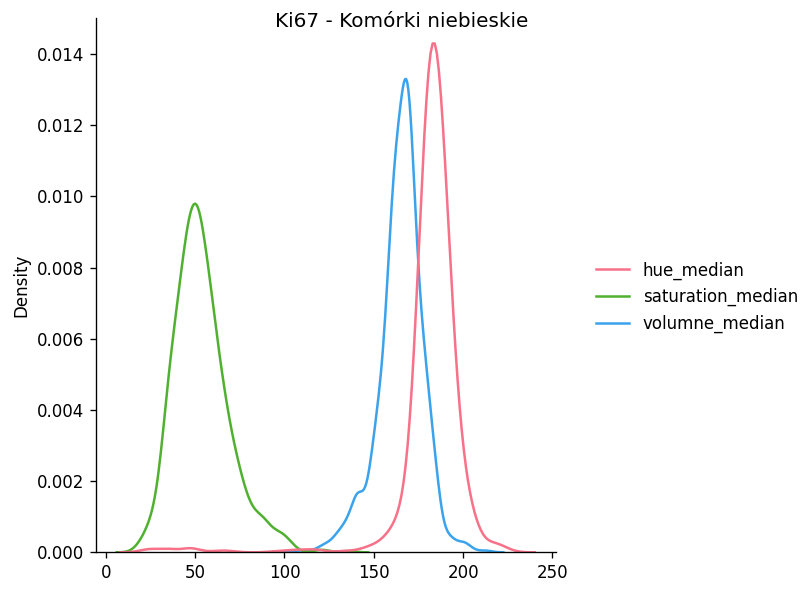

In [341]:
colors = ["#FF0B04", "#5AFF00"]
sns.set_palette(sns.color_palette(colors))
plot = sns.displot(color_df_1,kind="kde")
plot.fig.suptitle("Ki67 - Komórki niebieskie")

In [342]:
color_df_2=pd.DataFrame(color_dist_2_mean,columns=['hue_median','saturation_median','volumne_median'])

Text(0.5, 0.98, 'Ki67 - Komórki brąz')

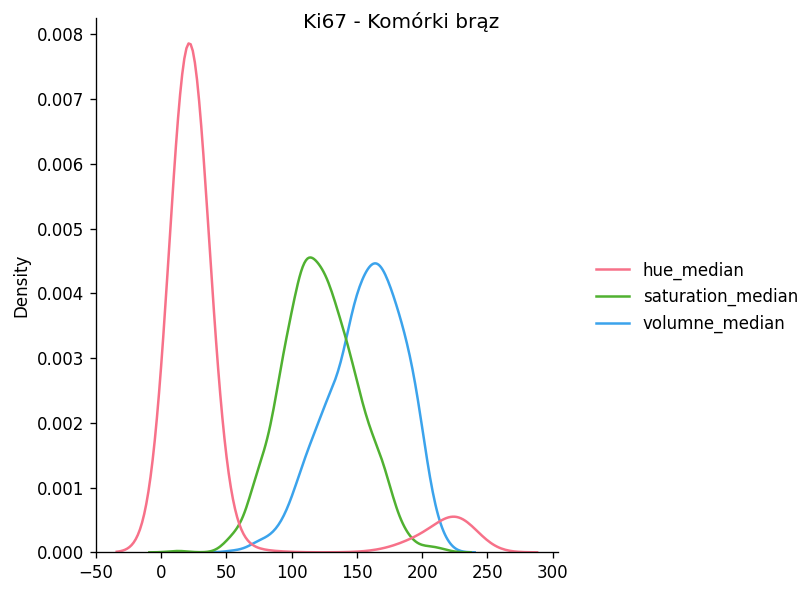

In [343]:
colors = ["#FF0B04", "#5AFF00"]
sns.set_palette(sns.color_palette(colors))
plot = sns.displot(color_df_2,kind="kde")
plot.fig.suptitle("Ki67 - Komórki brąz")

# Distributions

In [189]:
sigma=statistics.pstdev(color_dist_1_mean['hue'])
mu=statistics.mean(color_dist_1_mean['hue'])
hue_dist = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_dist_1_mean['saturation'])
mu=statistics.mean(color_dist_1_mean['saturation'])
saturation_dist = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_dist_1_mean['volumne'])
mu=statistics.mean(color_dist_1_mean['volumne'])
volumne_dist = NormalDist(mu,sigma)


sigma=statistics.pstdev(color_dist_1_mean['hue_median'])
mu=statistics.mean(color_dist_1_mean['hue_median'])
hue_dist_m = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_dist_1_mean['saturation_median'])
mu=statistics.mean(color_dist_1_mean['saturation_median'])
saturation_dist_m = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_dist_1_mean['volumne_median'])
mu=statistics.mean(color_dist_1_mean['volumne_median'])
volumne_dist_m = NormalDist(mu,sigma)

KeyError: 'saturation'

In [203]:
sigma=statistics.pstdev(color_dist_1_mean['hue_median'])
mu=statistics.mean(color_dist_1_mean['hue_median'])
hue_dist_m = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_dist_1_mean['saturation_median'])
mu=statistics.mean(color_dist_1_mean['saturation_median'])
saturation_dist_m = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_dist_1_mean['volumne_median'])
mu=statistics.mean(color_dist_1_mean['volumne_median'])
volumne_dist_m = NormalDist(mu,sigma)
blue_cells_dist = {
    'hue':hue_dist,
    'saturation':saturation_dist,
    'volumne':volumne_dist,
    'hue_med':hue_dist_m,
    'saturation_med':saturation_dist_m,
    'volumne_med':volumne_dist_m,
}
for key in blue_cells_dist.keys():
    print(key)
    print(blue_cells_dist[key])

hue
NormalDist(mu=165.37925365424942, sigma=62.081081074003755)
saturation
NormalDist(mu=54.4358347724189, sigma=27.346911727504224)
volumne
NormalDist(mu=169.16350935148637, sigma=20.63630516774649)
hue_med
NormalDist(mu=181.82193268186754, sigma=19.730562858306044)
saturation_med
NormalDist(mu=53.71444082519001, sigma=15.51944939029337)
volumne_med
NormalDist(mu=165.13680781758958, sigma=12.44291033504001)


In [188]:
sigma=statistics.pstdev(color_dist_2_mean['hue'])
mu=statistics.mean(color_dist_2_mean['hue'])
red_dist = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_dist_2_mean['saturation'])
mu=statistics.mean(color_dist_2_mean['saturation'])
blue_dist = NormalDist(mu,sigma)

sigma=statistics.pstdev(color_dist_2_mean['volumne'])
mu=statistics.mean(color_dist_2_mean['volumne'])
green_dist = NormalDist(mu,sigma)

KeyError: 'saturation'

In [75]:
brown_cells_dist = {
    'hue':blue_dist,
    'saturation':red_dist,
    'volumne':green_dist,
}

In [76]:
for key in brown_cells_dist.keys():
    print(brown_cells_dist[key])

NormalDist(mu=118.53908256780164, sigma=26.86859414394236)
NormalDist(mu=53.267667061885085, sigma=41.10410347641944)
NormalDist(mu=157.77493487411914, sigma=25.612694738866654)


In [77]:
plot_list_red_1 = []
plot_list_blue_1 = []
plot_list_green_1 = []

plot_list_red_2 = []
plot_list_blue_2 = []
plot_list_green_2 = []

for i in range(255):
    plot_list_red_1.append(blue_cells_dist['hue'].pdf(i))
    plot_list_green_1.append(blue_cells_dist['saturation'].pdf(i))
    plot_list_blue_1.append(blue_cells_dist['volumne'].pdf(i))

    plot_list_red_2.append(brown_cells_dist['hue'].pdf(i))
    plot_list_blue_2.append(brown_cells_dist['saturation'].pdf(i))
    plot_list_green_2.append(brown_cells_dist['volumne'].pdf(i))
    

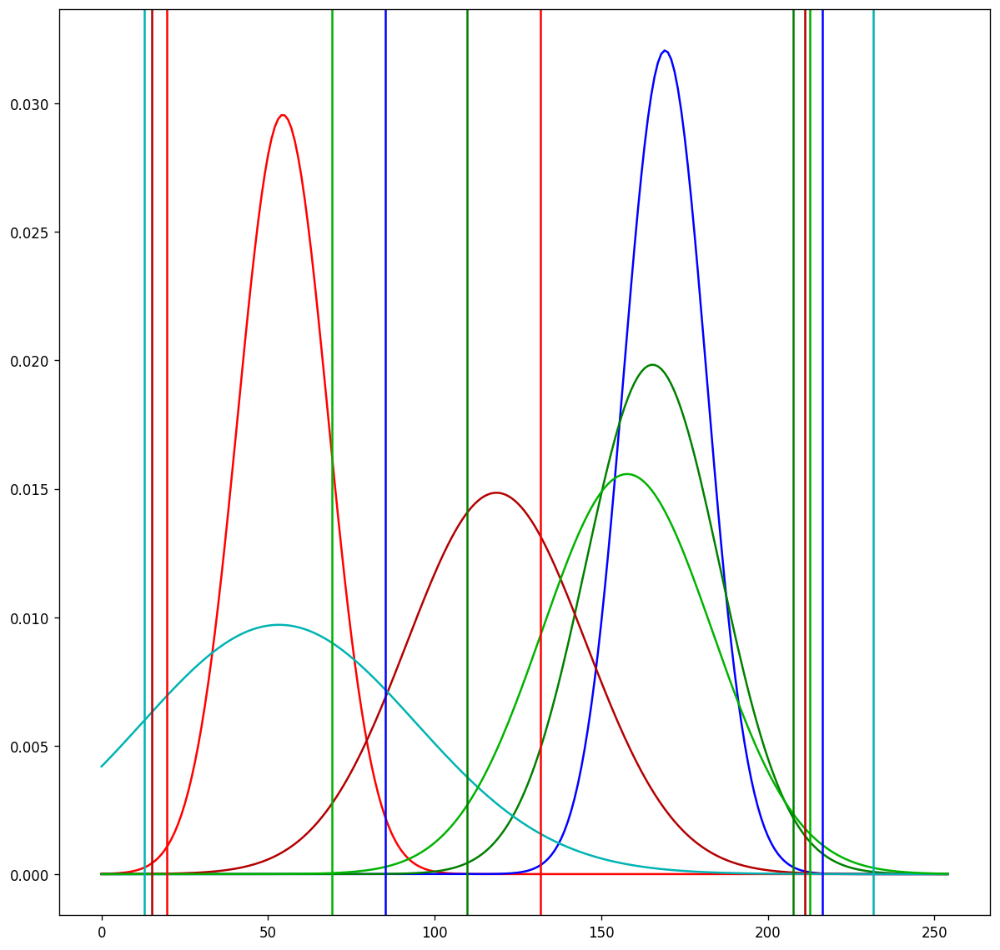

In [78]:
plt.plot(plot_list_red_1,color='red')

plt.plot(plot_list_blue_1,color='blue')

plt.plot(plot_list_green_1,color='green')



plt.plot(plot_list_red_2,color='#b30000')


plt.plot(plot_list_blue_2,color='#00b3b3')

plt.plot(plot_list_green_2,color="#00b300")

plt.axvline(r1_min, 0, 1,color='red')
plt.axvline(r1_max, 0, 1,color='red')
plt.axvline(b1_min, 0, 1,color='blue')
plt.axvline(b1_max, 0, 1,color='blue')
plt.axvline(g1_min, 0, 1,color='green')
plt.axvline(g1_max, 0, 1,color='green')
plt.axvline(r2_min, 0, 1,color='#b30000')
plt.axvline(r2_max, 0, 1,color='#b30000')
plt.axvline(g2_min, 0, 1,color='#00b300')
plt.axvline(g2_max, 0, 1,color='#00b300')
plt.axvline(b2_min, 0, 1,color='#00b3b3')
plt.axvline(b2_max, 0, 1,color='#00b3b3')
plt.show()

In [79]:
[b1_min,b1_max,r1_min,r1_max,g1_min,g1_min]

[85.22252010723861,
 216.49247121346323,
 19.528991971454058,
 131.70999115826703,
 109.70291777188329,
 109.70291777188329]

In [80]:
[b2_min,b2_max,r2_min,r2_max,g2_min,g2_min]

[12.89897592028785,
 231.64051747866776,
 15.096042070301689,
 211.10350538227988,
 69.07412510333425,
 69.07412510333425]

# Mesh

In [24]:
elipses_colors = {'1':"blue",
         '2':'red'}

def show_ellipses(res,filename):
    filepath = os.path.join(data_path,filename+".jpg")
    assert os.path.exists(filepath)
    print(filepath)
    img = mpimg.imread(filepath)
    ax = plt.gca()
    for ids, row in res[res.img_name==filename].iterrows():
        label = str(row.label)
        ax.add_patch(Ellipse((row.center_x,row.center_y),
                                width=row.radius_x*2,
                                height=row.radius_y*2,
                                angle=rad_to_deg(row.theta), 
                                facecolor='none',
                                edgecolor=row.color))
        
    plt.imshow(img)

In [6]:
results_file = "../src/results_elipses/results_p1_0299_6_mesh_blue.pickle"
assert os.path.exists(results_file)

In [622]:
with open(results_file, 'rb') as handle:
    res_mesh = pickle.load(handle)

In [623]:
res_mesh

,center_x,center_y,theta,colors,radius_x,radius_y,label,img_name,pdf_h,pdf_s,pdf_v,median_v,color,num_pixels,color_ratio,rat
0,0,0,0,"[(36, 31, 235), (36, 31, 236), (37, 33, 237), ...",18,20,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,blue,300,0,0.000000
1,18,20,0,"[(36, 36, 235), (42, 37, 234), (41, 34, 236), ...",18,20,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,blue,1121,0,0.000000
2,36,0,0,"[(36, 31, 236), (36, 31, 236), (36, 31, 237), ...",18,20,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,blue,579,0,0.000000
3,54,20,0,"[(36, 38, 231), (36, 37, 229), (36, 38, 230), ...",18,20,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,blue,1121,0,0.000000
4,72,0,0,"[(37, 36, 232), (37, 36, 232), (37, 36, 233), ...",18,20,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,blue,579,2,0.003454
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2100,1080,1200,0,"[(199, 26, 155), (192, 51, 157), (190, 49, 159...",18,20,1,p1_0299_6,0.006498,0.011664,0.016869,200.0,blue,1121,663,0.591436
2101,1116,1200,0,"[(5, 38, 217), (22, 43, 224), (22, 43, 222), (...",18,20,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,blue,1121,0,0.000000
2102,1152,1200,0,"[(30, 42, 233), (31, 34, 227), (33, 36, 229), ...",18,20,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,blue,1121,4,0.003568
2103,1188,1200,0,"[(153, 60, 177), (172, 62, 163), (167, 62, 167...",18,20,1,p1_0299_6,0.009082,0.012255,0.010308,168.0,blue,1121,329,0.293488


In [624]:
res_mesh[res_mesh.index==85]

,center_x,center_y,theta,colors,radius_x,radius_y,label,img_name,pdf_h,pdf_s,pdf_v,median_v,color,num_pixels,color_ratio,rat
85,288,40,0,"[(34, 40, 221), (36, 46, 218), (35, 44, 218), ...",18,20,1,p1_0299_6,0.0,0.0,0.0,0.0,blue,1121,47,0.041927


..\data\Ki67\SHIDC-B-Ki-67\Train\p1_0299_6.jpg


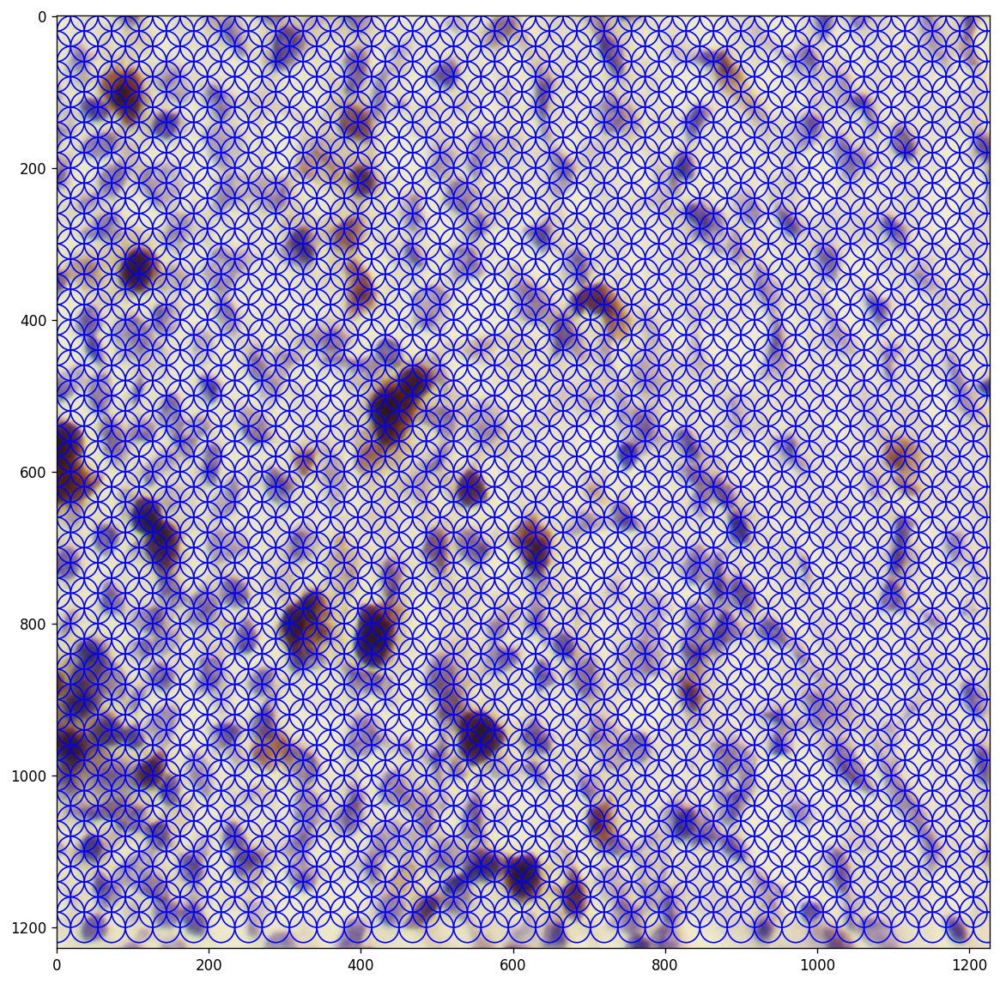

In [625]:
show_ellipses(res_mesh,'p1_0299_6')

# Mesh intresting points

In [626]:
results_file = "../src/results_elipses/results_p1_0299_6_meshFinal_blue.pickle"
assert os.path.exists(results_file)

In [627]:
with open(results_file, 'rb') as handle:
    res_mesh = pickle.load(handle)

In [628]:
res_mesh

,center_x,center_y,theta,colors,radius_x,radius_y,label,img_name,pdf_h,pdf_s,pdf_v,median_v,color,color_ratio,num_pixels,rat
0,234,20,0,"[(181, 25, 152), (229, 37, 150), (220, 36, 147...",18,20,1,p1_0299_6,0.008656,0.012751,0.016397,187.0,blue,708,1121,0.631579
1,396,0,0,"[(171, 54, 144), (176, 57, 141), (176, 57, 143...",18,20,1,p1_0299_6,0.004385,0.009832,0.019238,218.0,blue,429,579,0.740933
2,1008,0,0,"[(34, 35, 218), (33, 32, 217), (31, 30, 215), ...",18,20,1,p1_0299_6,0.015496,0.008764,0.016464,178.0,blue,308,579,0.531952
3,990,60,0,"[(228, 22, 180), (196, 19, 172), (188, 20, 175...",18,20,1,p1_0299_6,0.010008,0.012183,0.014025,184.0,blue,589,1121,0.525424
4,216,120,0,"[(94, 16, 196), (196, 19, 170), (200, 10, 169)...",18,20,1,p1_0299_6,0.013981,0.009724,0.021044,186.0,blue,720,1121,0.642284
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75,180,1200,0,"[(42, 39, 220), (65, 21, 198), (58, 26, 200), ...",18,20,1,p1_0299_6,0.012744,0.009730,0.012928,175.0,blue,578,1121,0.515611
76,396,1200,0,"[(187, 6, 185), (29, 15, 209), (18, 11, 205), ...",18,20,1,p1_0299_6,0.010194,0.013983,0.012736,186.0,blue,573,1121,0.511151
77,756,1200,0,"[(0, 15, 192), (212, 17, 175), (216, 14, 172),...",18,20,1,p1_0299_6,0.011716,0.012973,0.019090,195.0,blue,710,1121,0.633363
78,792,1200,0,"[(26, 55, 226), (29, 54, 225), (28, 51, 227), ...",18,20,1,p1_0299_6,0.008416,0.013686,0.013616,183.0,blue,605,1121,0.539697


..\data\Ki67\SHIDC-B-Ki-67\Train\p1_0299_6.jpg


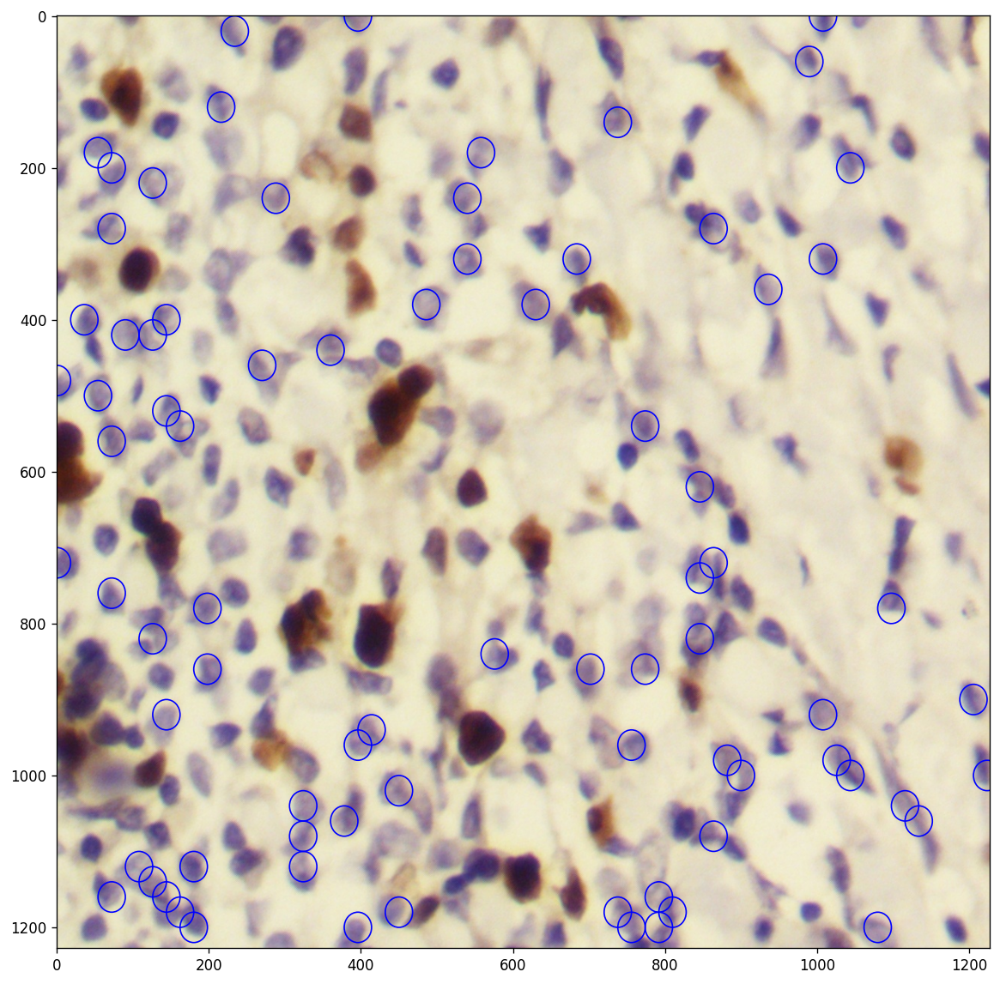

In [629]:
show_ellipses(res_mesh,'p1_0299_6')

In [630]:
res_mesh[res_mesh.index==2]

,center_x,center_y,theta,colors,radius_x,radius_y,label,img_name,pdf_h,pdf_s,pdf_v,median_v,color,color_ratio,num_pixels,rat
2,1008,0,0,"[(34, 35, 218), (33, 32, 217), (31, 30, 215), ...",18,20,1,p1_0299_6,0.015496,0.008764,0.016464,178.0,blue,308,579,0.531952


In [605]:
res_mesh[res_mesh.index==3]

,center_x,center_y,theta,colors,radius_x,radius_y,label,img_name,pdf_h,pdf_s,pdf_v,median_v,color,color_ratio,num_pixels,rat
3,429,805,0,"[(181, 21, 128), (113, 13, 115), (136, 10, 117...",33,35,1,p1_0299_6,0.018279,0.008773,0.00624,200.0,brown,2171,3613,0.600886


# Elipses check from experiment

In [719]:
results_file = "../src/results_elipses/results_p1_0299_6_meshFinal_brown.pickle"
assert os.path.exists(results_file)
with open(results_file, 'rb') as handle:
    res_elipses = pickle.load(handle)

In [720]:
res_elipses

,center_x,center_y,theta,colors,radius_x,radius_y,label,img_name,pdf_h,pdf_s,pdf_v,median_v,color,color_ratio,num_pixels,rat
0,99,35,0,"[(30, 45, 220), (31, 50, 219), (30, 51, 223), ...",33,35,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,brown,3044,3613,0.842513
1,132,0,0,"[(221, 62, 122), (221, 56, 126), (225, 53, 129...",33,35,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,brown,933,1840,0.507065
2,264,0,0,"[(13, 35, 181), (13, 33, 188), (12, 32, 186), ...",33,35,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,brown,1033,1840,0.561413
3,330,0,0,"[(5, 54, 170), (9, 60, 185), (9, 58, 184), (9,...",33,35,1,p1_0299_6,0.028318,0.002013,0.005519,26.0,brown,1576,1840,0.856522
4,363,35,0,"[(20, 50, 203), (27, 50, 206), (30, 48, 204), ...",33,35,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,brown,2623,3613,0.725989
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167,660,1120,0,"[(190, 122, 79), (206, 117, 111), (202, 125, 1...",33,35,1,p1_0299_6,0.018870,0.003950,0.003917,33.0,brown,2613,3613,0.723222
168,693,1155,0,"[(10, 57, 176), (22, 70, 221), (18, 72, 208), ...",33,35,1,p1_0299_6,0.019263,0.005325,0.006513,36.0,brown,2262,3613,0.626073
169,462,1190,0,"[(166, 52, 165), (186, 68, 163), (187, 71, 160...",33,35,1,p1_0299_6,0.015070,0.002810,0.005358,38.0,brown,2240,3613,0.619983
170,594,1190,0,"[(34, 36, 223), (29, 42, 230), (29, 41, 231), ...",33,35,1,p1_0299_6,0.000000,0.000000,0.000000,0.0,brown,2013,3613,0.557155


..\data\Ki67\SHIDC-B-Ki-67\Train\p1_0299_6.jpg


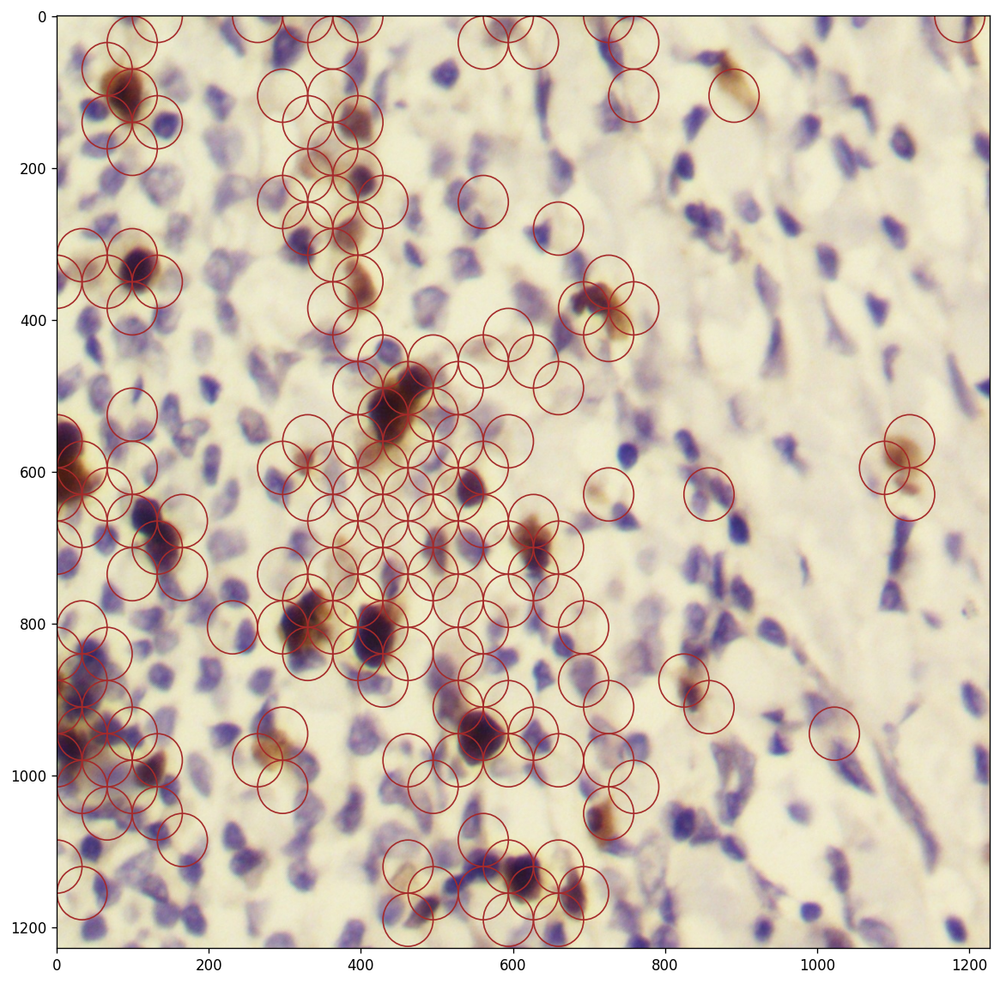

In [721]:
show_ellipses(res_elipses,'p1_0299_6')

..\data\Ki67\SHIDC-B-Ki-67\Train\p1_0299_6.jpg
2    0.509826
Name: rat, dtype: float64


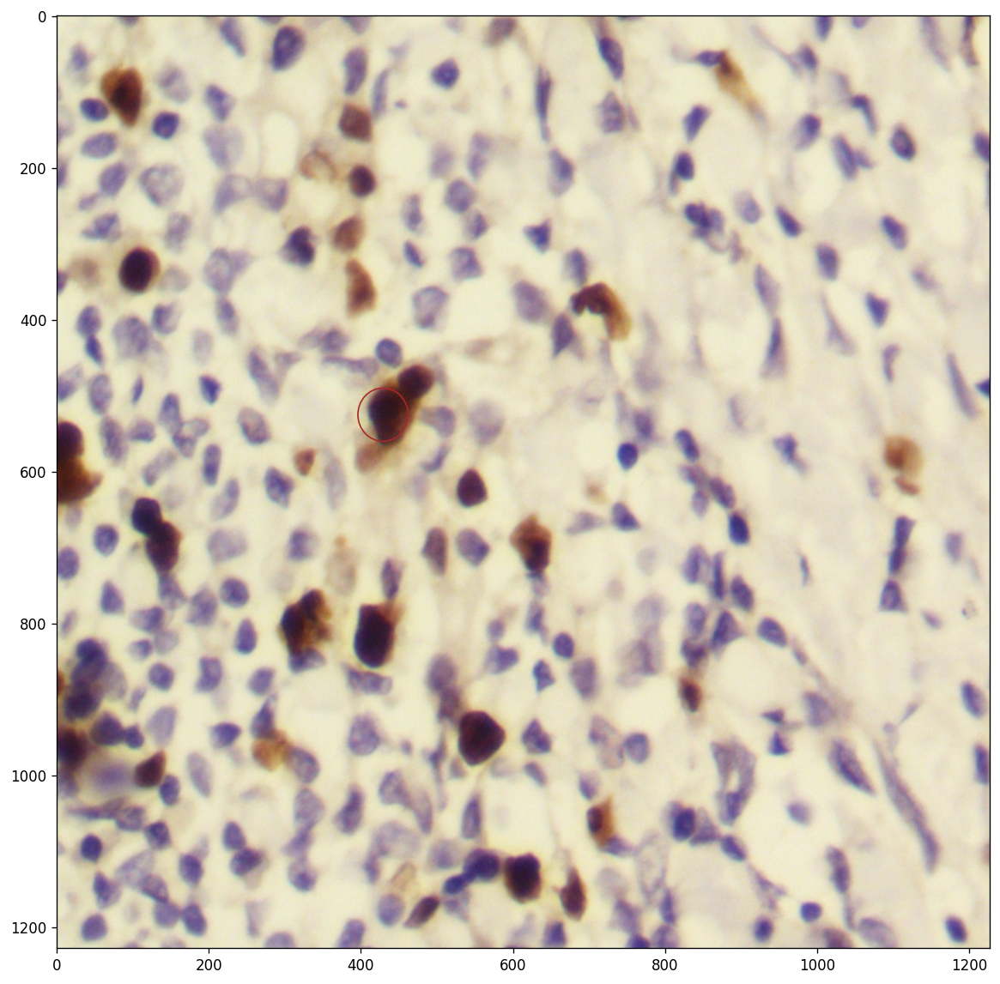

In [690]:
index =2
show_ellipses(res_elipses[res_elipses.index==index],'p1_0299_6')
print(res_elipses[res_elipses.index==index].rat)

In [695]:
col=res_elipses[res_elipses.index==index].colors.values[0]

In [699]:
h,s,v = zip(*col)

Text(0.5, 0.98, 'Ki67 - Komórki brąz')

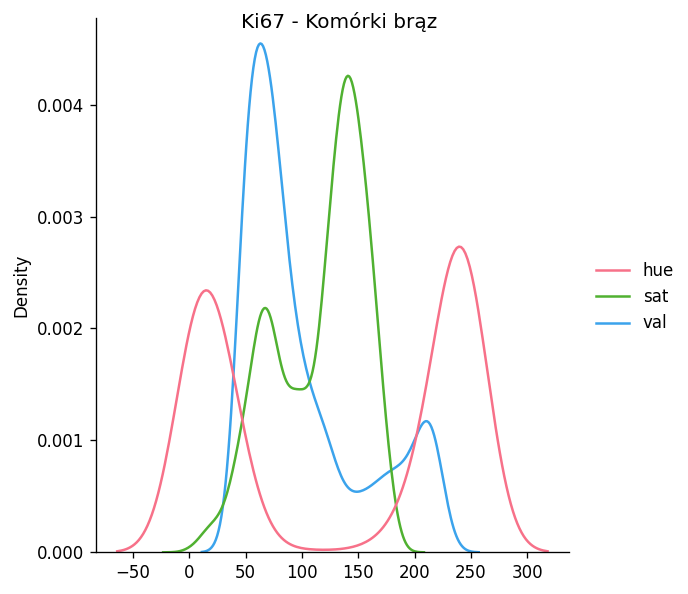

In [701]:
colors = ["#FF0B04", "#5AFF00"]
di = {'hue':h,
     'sat':s,
     'val':v}
color_df = pd.DataFrame(di)
sns.set_palette(sns.color_palette())
plot = sns.displot(color_df,kind="kde")
plot.fig.suptitle("Ki67 - Komórki brąz")

0

..\data\Ki67\SHIDC-B-Ki-67\Train\p1_0299_6.jpg


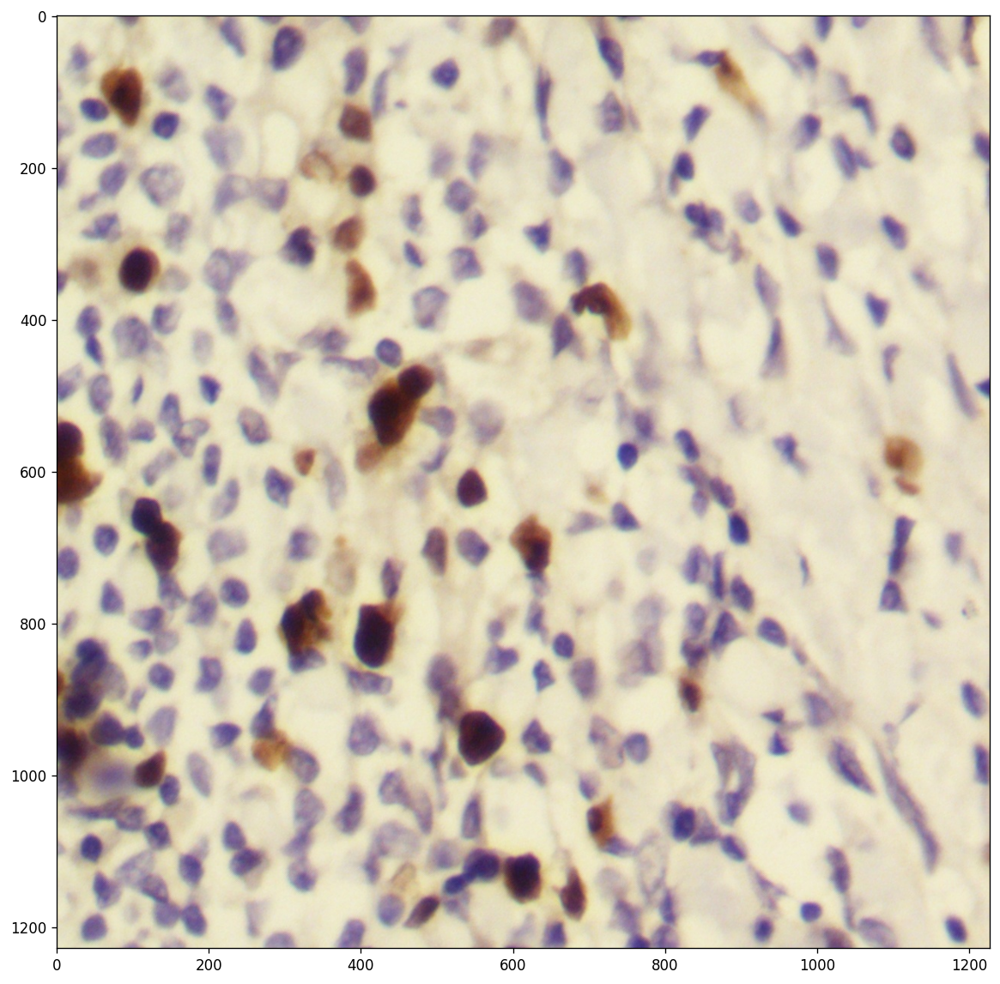

In [355]:
show_ellipses(res_elipses[res_elipses.color_ratio==1],'p1_0299_6')

# Overlapping

In [25]:
img_name = "p1_0299_1_z_testowego"
prefix = "big shake"
results_file_brown = f"../src/results_elipses/results_{img_name}_overlap_brown_{prefix}.pickle"
results_file_blue = f"../src/results_elipses/results_{img_name}_overlap_blue_{prefix}.pickle"
assert os.path.exists(results_file_brown)
assert os.path.exists(results_file_blue)
data_path = Path("../data/Ki67/SHIDC-B-Ki-67/Train/")
with open(results_file_blue, 'rb') as handle:
    res_elipses_blue = pickle.load(handle)
    
with open(results_file_brown, 'rb') as handle:
    res_elipses_brown = pickle.load(handle)

In [26]:
res_elipses_blue

,center_x,center_y,theta,colors,radius_x,radius_y,label,img_name,pdf_h,pdf_s,pdf_v,median_v,color,num_pixels,rat,metric_value,metric
0,1080,0,0,"[(178, 78, 146), (175, 78, 143), (175, 69, 146...",18.0,20.0,1,p1_0299_1_z_testowego,0.008899,0.012185,0.007419,185.0,blue,579,0.556569,NaN,NaN
1,342,60,0,"[(93, 6, 185), (70, 4, 183), (59, 7, 182), (59...",18.0,20.0,1,p1_0299_1_z_testowego,0.010647,0.007006,0.015877,168.0,blue,1121,0.461407,NaN,NaN
2,576,120,0,"[(208, 15, 180), (205, 8, 174), (200, 10, 170)...",18.0,20.0,1,p1_0299_1_z_testowego,0.000000,0.000000,0.000000,0.0,blue,1121,0.677521,NaN,NaN
3,0,240,0,"[(187, 57, 111), (184, 52, 116), (179, 55, 120...",18.0,20.0,1,p1_0299_1_z_testowego,0.012168,0.011289,0.008198,177.0,blue,581,0.362018,NaN,NaN
4,594,260,0,"[(35, 9, 167), (232, 18, 175), (239, 16, 173),...",18.0,20.0,1,p1_0299_1_z_testowego,0.004769,0.004114,0.013267,60.0,blue,1121,0.323054,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
389,274,1105,0,"[(203, 34, 142), (203, 24, 146), (200, 18, 150...",12.6,22.0,1,p1_0299_1_z_testowego,0.006488,0.007154,0.022413,200.0,blue,869,0.998276,0.998276,ratio
390,948,1112,0,"[(183, 56, 153), (184, 53, 152), (188, 56, 150...",12.6,14.0,1,p1_0299_1_z_testowego,0.024022,0.012171,0.024525,180.0,blue,549,273.999999,273.999999,ratio
391,492,1179,0,"[(42, 32, 221), (41, 33, 221), (41, 35, 223), ...",12.6,18.0,1,p1_0299_1_z_testowego,0.007899,0.005046,0.018470,162.0,blue,705,0.435013,0.435013,ratio
392,1158,1185,0,"[(184, 14, 160), (175, 12, 158), (177, 17, 162...",12.6,14.0,1,p1_0299_1_z_testowego,0.016804,0.012333,0.007624,194.0,blue,549,1.713710,1.713710,ratio


In [27]:
all_cells=res_elipses_blue.append(res_elipses_brown[res_elipses_brown.rat>0.80])

..\data\Ki67\SHIDC-B-Ki-67\Train\p1_0299_1_z_testowego.jpg


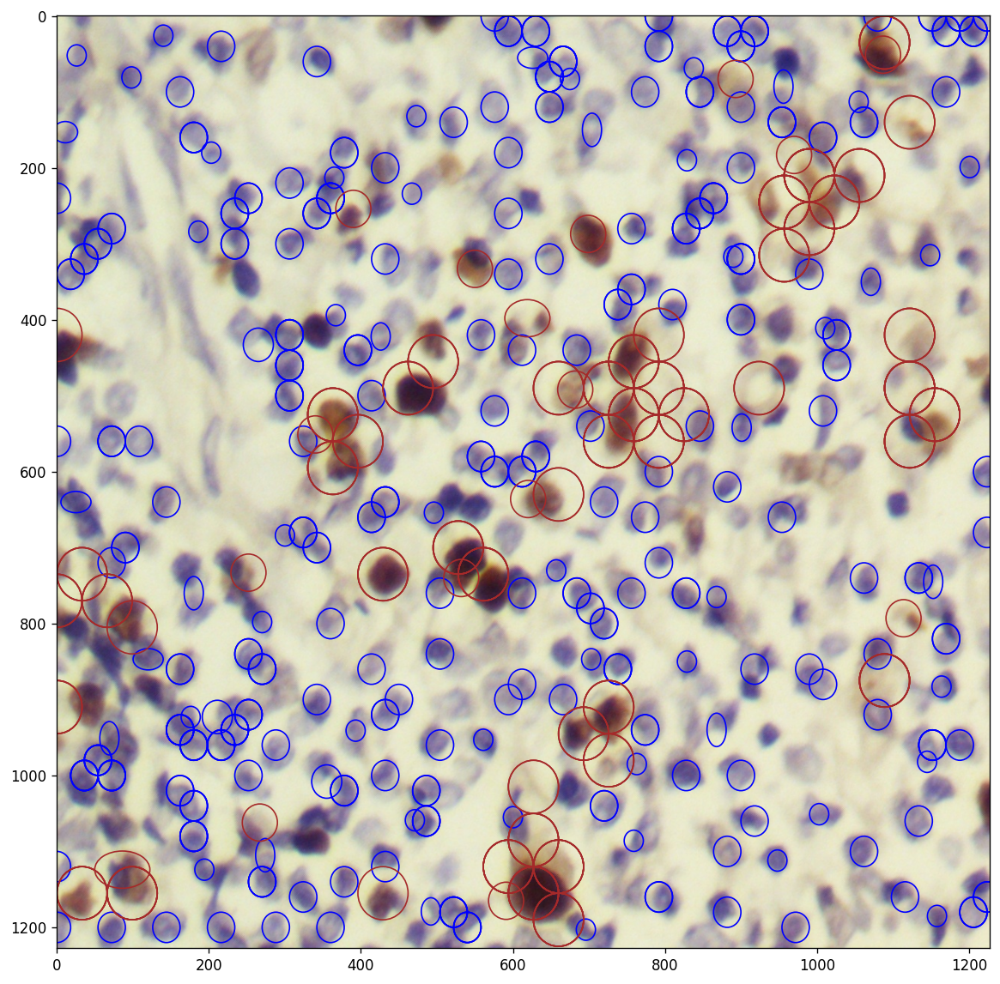

In [28]:
show_ellipses(all_cells,img_name)

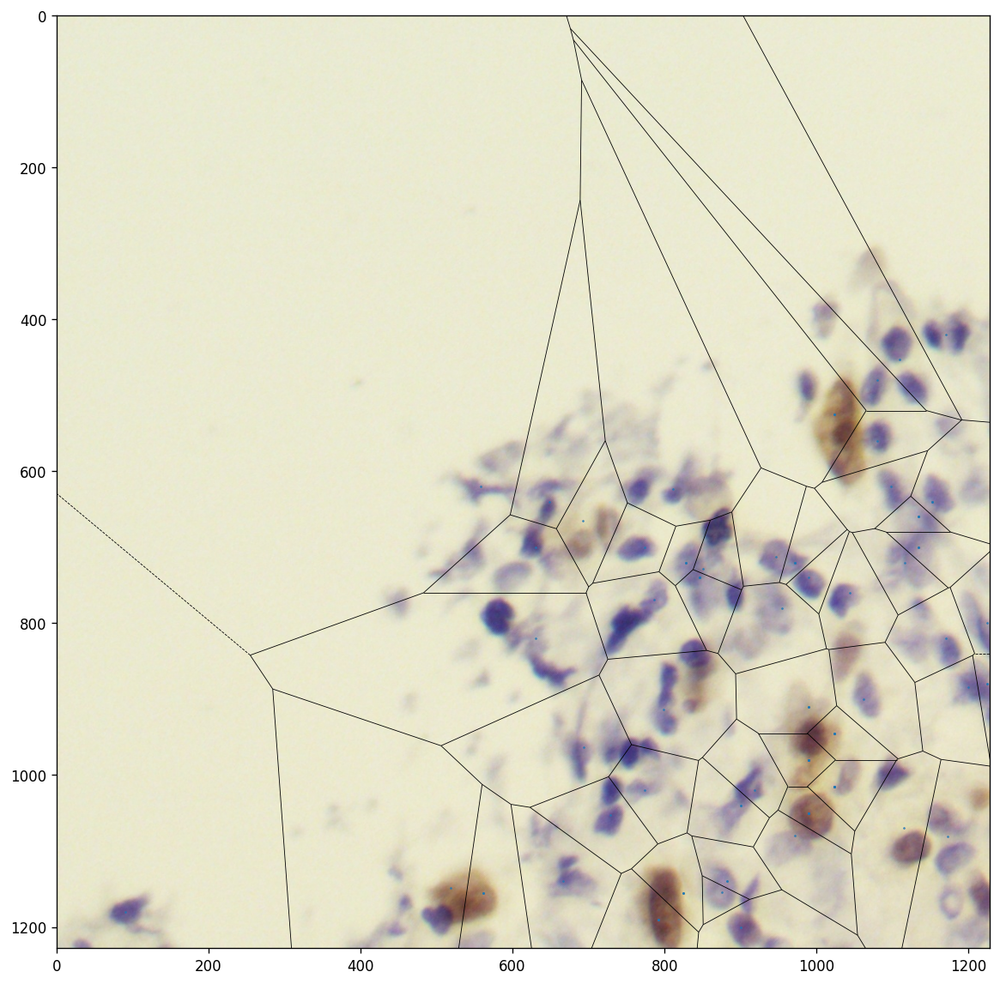

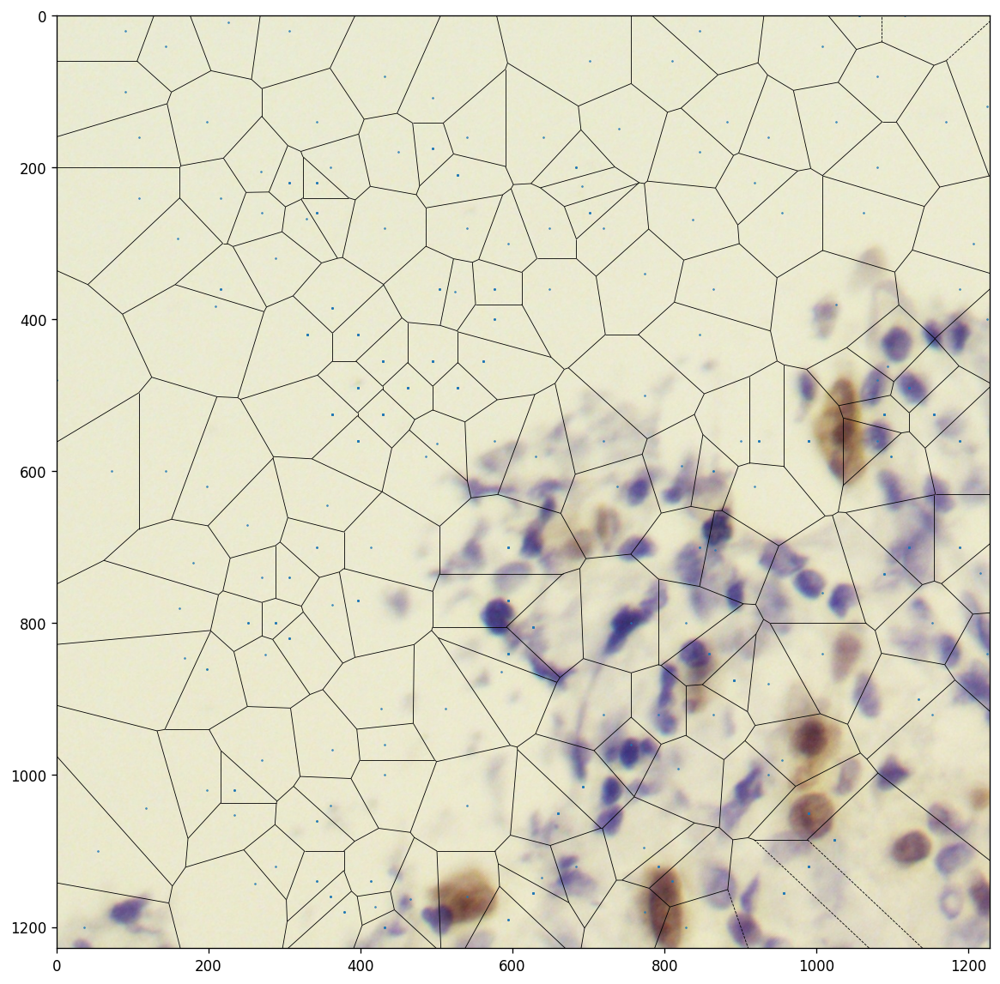

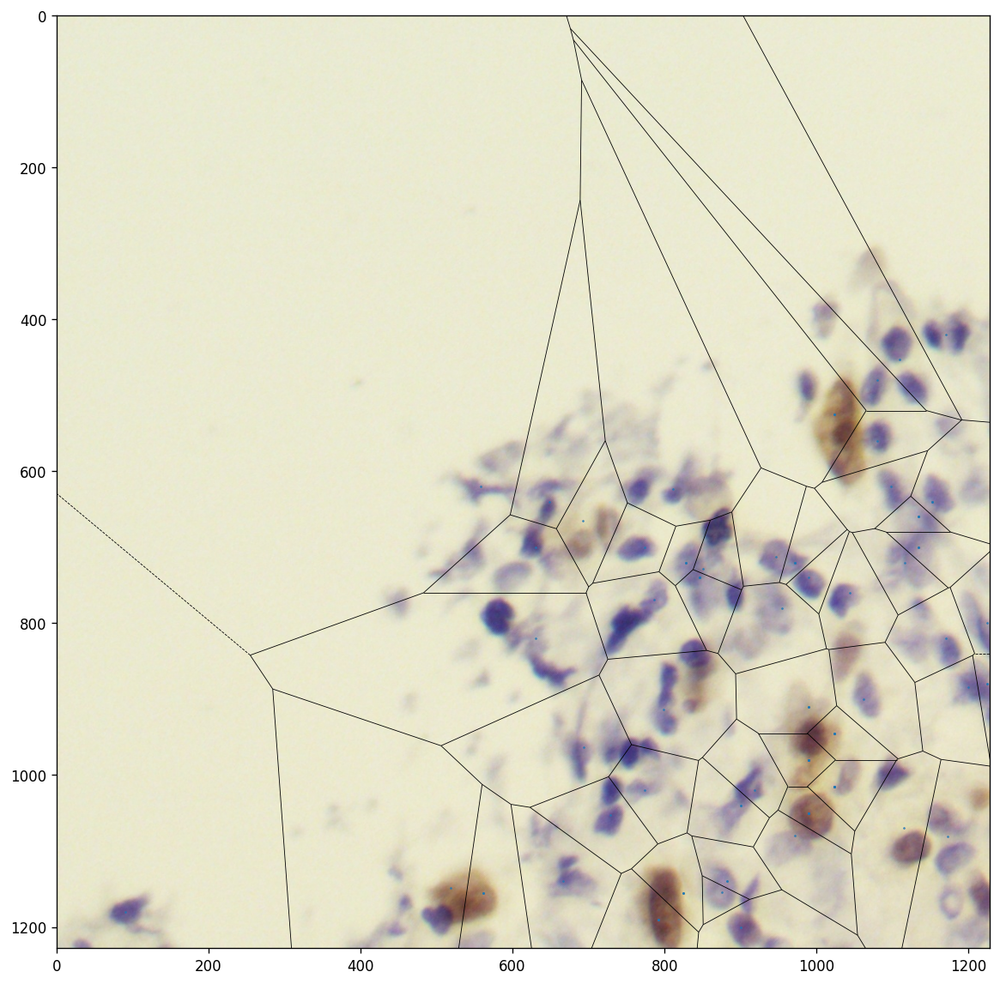

In [74]:
from src.utils.visualize import plot_voronoi
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
img_path = r"../data/Ki67/SHIDC-B-Ki-67/Train/"+img_name+".jpg"
img_arr = plt.imread(img_path)
plot_voronoi(vor,img_arr,show_points=True,show_verticles=False,line_width=0.5)
points = list(zip(all_cells.center_x,all_cells.center_y))
vor = Voronoi(points)
plot_voronoi(vor,img_arr,show_points=True,show_verticles=False,line_width=0.5)

In [219]:
from matplotlib.patches import Ellipse
from shapely.geometry import Polygon 

In [220]:
ellipse1 = Ellipse((e1.center_x, e1.center_y), e1.radius_x*2, e1.radius_y*2, e1.theta)
vertices = ellipse1.get_verts()
ellipse1 = Polygon(vertices)

In [221]:
ellipse2 = Ellipse((e2.center_x, e2.center_y), e2.radius_x*2, e2.radius_y*2, e2.theta)
vertices = ellipse2.get_verts()
ellipse2 = Polygon(vertices)

In [222]:
ellipse2.intersects(ellipse1)

True

In [223]:
def create_polygon(ellipse_row):
    ellipse1 = Ellipse((ellipse_row.center_x, ellipse_row.center_y), ellipse_row.radius_x*2, ellipse_row.radius_y*2, ellipse_row.theta)
    vertices = ellipse1.get_verts()
    ellipse1 = Polygon(vertices)
    return ellipse1
    

In [224]:
ellipses["polygons"]=ellipses.apply(create_polygon, axis=1)

In [225]:
not_overlapping = []

In [226]:
def check_overlapping_condition(ellipses):
    for idx, row in ellipses.iterrows():
        for idx2, row2 in ellipses.iterrows():
            if idx!=idx2:
                 if row.polygons.intersects(row2.polygons):
                    return True
    return False

In [255]:
ellipses_tmp=ellipses[['center_x','center_y','theta','radius_x','radius_y','polygons']]
while check_overlapping_condition(ellipses_tmp):
    for idx, row in ellipses_tmp.iterrows():
        min_check_dist = row.radius_x+row.radius_y
        for idx2, row2 in ellipses_tmp.iterrows():
            changed=False
            if idx != idx2:
                center_dist_x = abs(row.center_x-row2.center_x)
                center_dist_y = abs(row.center_y-row2.center_y)
                if center_dist_x < min_check_dist or center_dist_y < min_check_dist:
                    print('check',idx,idx2)
                    if row.polygons.intersects(row2.polygons):
                        print('over')
                        mean_center_x = (row.center_x + row2.center_x)/2
                        mean_center_y = (row.center_y + row2.center_y)/2
                        mean_radius_x = (row.radius_x+row2.radius_x)/2
                        mean_radius_y = (row.radius_y+row2.radius_y)/2
                        mean_theta = (row.theta + row2.theta)/2
                        new_ellipse = {
                            'center_x':mean_center_x,
                            'center_y':mean_center_y,
                            'theta':mean_theta,
                            'radius_x':mean_radius_x,
                            'radius_y':mean_radius_y,
                            'polygons':None
                            
                        }
                        ellipses_tmp=ellipses_tmp.drop(idx)
                        ellipses_tmp=ellipses_tmp.drop(idx2)
                        ellipses_tmp=ellipses_tmp.append(new_ellipse, ignore_index=True)
                        ellipses_tmp.iloc[-1, ellipses_tmp.columns.get_loc('polygons')] = create_polygon(ellipses_tmp.iloc[-1])
                        changed=True
                        break
        if changed:
            break

check 21 348
check 21 444
check 21 480
check 21 774
check 348 21
check 348 444
check 348 480
check 348 774
check 444 21
check 444 348
check 444 480
over


..\data\Ki67\SHIDC-B-Ki-67\Train\p1_0299_6.jpg


KeyError: True

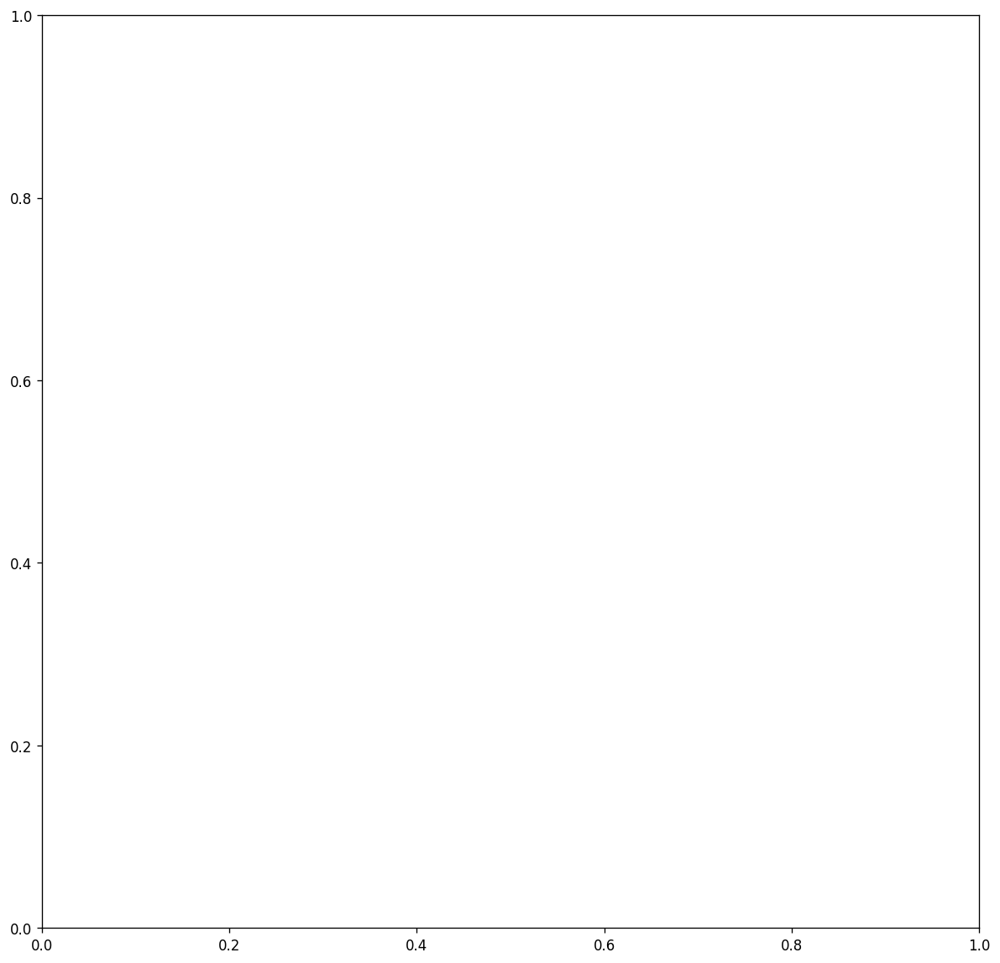

In [263]:
show_ellipses(ellipses_tmp,'p1_0299_6')

In [261]:
ellipses_tmp.img_name = "p1_0299_6"

In [262]:
ellipses_tmp

,center_x,center_y,theta,radius_x,radius_y,polygons
0,18.0,60.0,0.0,23.4,26.0,"POLYGON ((18 34, 20.31924044926142 34.08561012..."
1,12.0,494.0,0.0,23.4,26.0,"POLYGON ((12 468, 14.31924044926142 468.085610..."
2,12.0,1014.0,0.0,23.4,26.0,"POLYGON ((12 988, 14.31924044926142 988.085610..."
3,12.0,718.5,0.0,23.4,26.0,"POLYGON ((12 692.5, 14.31924044926142 692.5856..."


In [236]:
new_ellipse

{'center_x': 12.0,
 'center_y': 718.5,
 'theta': 0.0,
 'radius_x': 23.4,
 'radius_y': 26.0,
 'polygons': None}

In [264]:
x=[(1,2),(3,2),(5,3)]

In [275]:
combo = list(combinations(x,2))

In [276]:
from itertools import combinations

In [277]:
combo

[((1, 2), (3, 2)), ((1, 2), (5, 3)), ((3, 2), (5, 3))]

In [414]:
x=(1,2)

In [415]:
y=(3,2)

In [417]:
d=[]

In [418]:
d.append(set(x))

In [419]:
d

[{1, 2}]